<a href="https://colab.research.google.com/github/ysamia/ysamia/blob/main/Flight_Delay_Prediction_ML_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Flight Delay Prediction

###Installing and opening datasets

In [2]:
!pip install pandas-profiling numpy matplotlib seaborn --quiet

In [3]:
!pip install opendatasets scikit-learn jovian --quiet --upgrade

In [4]:
import opendatasets as od
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib
import jovian
import os
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 150)
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

Downloading data from Kaggle

In [5]:
od.download('https://www.kaggle.com/divyansh22/flight-delay-prediction')

Skipping, found downloaded files in "./flight-delay-prediction" (use force=True to force download)


In [6]:
os.listdir('flight-delay-prediction')

['Jan_2019_ontime.csv', 'Jan_2020_ontime.csv']

In [7]:
jan_2019_df = pd.read_csv('./flight-delay-prediction/Jan_2019_ontime.csv')
jan_2020_df = pd.read_csv('./flight-delay-prediction/Jan_2020_ontime.csv')

In [8]:
jan_2019_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
0,1,2,9E,20363,9E,N8688C,3280,11953,1195302,GNV,10397,1039707,ATL,601.0,0.0,0600-0659,722.0,0.0,0.0,0.0,300.0,NaN
1,1,2,9E,20363,9E,N348PQ,3281,13487,1348702,MSP,11193,1119302,CVG,1359.0,0.0,1400-1459,1633.0,0.0,0.0,0.0,596.0,NaN
2,1,2,9E,20363,9E,N8896A,3282,11433,1143302,DTW,11193,1119302,CVG,1215.0,0.0,1200-1259,1329.0,0.0,0.0,0.0,229.0,NaN
3,1,2,9E,20363,9E,N8886A,3283,15249,1524906,TLH,10397,1039707,ATL,1521.0,0.0,1500-1559,1625.0,0.0,0.0,0.0,223.0,NaN
4,1,2,9E,20363,9E,N8974C,3284,10397,1039707,ATL,11778,1177801,FSM,1847.0,0.0,1900-1959,1940.0,0.0,0.0,0.0,579.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583980,31,4,UA,19977,UA,N776UA,200,12016,1201602,GUM,12173,1217305,HNL,749.0,0.0,0700-0759,1832.0,0.0,0.0,0.0,3801.0,NaN
583981,31,4,UA,19977,UA,N36280,174,12016,1201602,GUM,14955,1495503,SPN,717.0,0.0,0700-0759,759.0,0.0,0.0,0.0,129.0,NaN
583982,31,4,UA,19977,UA,N36280,117,14955,1495503,SPN,12016,1201602,GUM,857.0,0.0,0900-0959,933.0,0.0,0.0,0.0,129.0,NaN
583983,31,4,UA,19977,UA,N39726,105,14955,1495503,SPN,12016,1201602,GUM,1820.0,0.0,1800-1859,1854.0,0.0,0.0,0.0,129.0,NaN


In [9]:
jan_2020_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
0,1,3,EV,20366,EV,N48901,4397,13930,1393007,ORD,11977,1197705,GRB,1003.0,0.0,1000-1059,1117.0,0.0,0.0,0.0,174.0,NaN
1,1,3,EV,20366,EV,N16976,4401,15370,1537002,TUL,13930,1393007,ORD,1027.0,0.0,1000-1059,1216.0,0.0,0.0,0.0,585.0,NaN
2,1,3,EV,20366,EV,N12167,4404,11618,1161802,EWR,15412,1541205,TYS,1848.0,0.0,1800-1859,2120.0,0.0,0.0,0.0,631.0,NaN
3,1,3,EV,20366,EV,N14902,4405,10781,1078105,BTR,12266,1226603,IAH,1846.0,0.0,1800-1859,2004.0,0.0,0.0,0.0,253.0,NaN
4,1,3,EV,20366,EV,N606UX,4407,14524,1452401,RIC,12266,1226603,IAH,1038.0,0.0,1000-1059,1330.0,0.0,0.0,0.0,1157.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
607341,31,5,9E,20363,9E,N331CA,4812,15412,1541205,TYS,11433,1143302,DTW,1002.0,1.0,0700-0759,1128.0,1.0,0.0,0.0,443.0,NaN
607342,31,5,9E,20363,9E,N295PQ,4813,11433,1143302,DTW,12478,1247805,JFK,1747.0,0.0,1700-1759,1933.0,0.0,0.0,0.0,509.0,NaN
607343,31,5,9E,20363,9E,N294PQ,4814,11996,1199603,GSP,12953,1295304,LGA,554.0,0.0,0600-0659,752.0,0.0,0.0,0.0,610.0,NaN
607344,31,5,9E,20363,9E,N228PQ,4815,10397,1039707,ATL,15919,1591904,XNA,1714.0,0.0,1700-1759,1811.0,0.0,0.0,0.0,589.0,NaN


In [10]:
raw_df = pd.concat(objs = [jan_2019_df, jan_2020_df], ignore_index = True)
raw_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
0,1,2,9E,20363,9E,N8688C,3280,11953,1195302,GNV,10397,1039707,ATL,601.0,0.0,0600-0659,722.0,0.0,0.0,0.0,300.0,NaN
1,1,2,9E,20363,9E,N348PQ,3281,13487,1348702,MSP,11193,1119302,CVG,1359.0,0.0,1400-1459,1633.0,0.0,0.0,0.0,596.0,NaN
2,1,2,9E,20363,9E,N8896A,3282,11433,1143302,DTW,11193,1119302,CVG,1215.0,0.0,1200-1259,1329.0,0.0,0.0,0.0,229.0,NaN
3,1,2,9E,20363,9E,N8886A,3283,15249,1524906,TLH,10397,1039707,ATL,1521.0,0.0,1500-1559,1625.0,0.0,0.0,0.0,223.0,NaN
4,1,2,9E,20363,9E,N8974C,3284,10397,1039707,ATL,11778,1177801,FSM,1847.0,0.0,1900-1959,1940.0,0.0,0.0,0.0,579.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1191326,31,5,9E,20363,9E,N331CA,4812,15412,1541205,TYS,11433,1143302,DTW,1002.0,1.0,0700-0759,1128.0,1.0,0.0,0.0,443.0,NaN
1191327,31,5,9E,20363,9E,N295PQ,4813,11433,1143302,DTW,12478,1247805,JFK,1747.0,0.0,1700-1759,1933.0,0.0,0.0,0.0,509.0,NaN
1191328,31,5,9E,20363,9E,N294PQ,4814,11996,1199603,GSP,12953,1295304,LGA,554.0,0.0,0600-0659,752.0,0.0,0.0,0.0,610.0,NaN
1191329,31,5,9E,20363,9E,N228PQ,4815,10397,1039707,ATL,15919,1591904,XNA,1714.0,0.0,1700-1759,1811.0,0.0,0.0,0.0,589.0,NaN


In [11]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1191331 entries, 0 to 1191330
Data columns (total 22 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   DAY_OF_MONTH           1191331 non-null  int64  
 1   DAY_OF_WEEK            1191331 non-null  int64  
 2   OP_UNIQUE_CARRIER      1191331 non-null  object 
 3   OP_CARRIER_AIRLINE_ID  1191331 non-null  int64  
 4   OP_CARRIER             1191331 non-null  object 
 5   TAIL_NUM               1188090 non-null  object 
 6   OP_CARRIER_FL_NUM      1191331 non-null  int64  
 7   ORIGIN_AIRPORT_ID      1191331 non-null  int64  
 8   ORIGIN_AIRPORT_SEQ_ID  1191331 non-null  int64  
 9   ORIGIN                 1191331 non-null  object 
 10  DEST_AIRPORT_ID        1191331 non-null  int64  
 11  DEST_AIRPORT_SEQ_ID    1191331 non-null  int64  
 12  DEST                   1191331 non-null  object 
 13  DEP_TIME               1168315 non-null  float64
 14  DEP_DEL15         

In [12]:
raw_df.dropna(subset=['DEP_DEL15','ARR_DEL15'],inplace=True)

In [13]:
raw_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
0,1,2,9E,20363,9E,N8688C,3280,11953,1195302,GNV,10397,1039707,ATL,601.0,0.0,0600-0659,722.0,0.0,0.0,0.0,300.0,NaN
1,1,2,9E,20363,9E,N348PQ,3281,13487,1348702,MSP,11193,1119302,CVG,1359.0,0.0,1400-1459,1633.0,0.0,0.0,0.0,596.0,NaN
2,1,2,9E,20363,9E,N8896A,3282,11433,1143302,DTW,11193,1119302,CVG,1215.0,0.0,1200-1259,1329.0,0.0,0.0,0.0,229.0,NaN
3,1,2,9E,20363,9E,N8886A,3283,15249,1524906,TLH,10397,1039707,ATL,1521.0,0.0,1500-1559,1625.0,0.0,0.0,0.0,223.0,NaN
4,1,2,9E,20363,9E,N8974C,3284,10397,1039707,ATL,11778,1177801,FSM,1847.0,0.0,1900-1959,1940.0,0.0,0.0,0.0,579.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1191326,31,5,9E,20363,9E,N331CA,4812,15412,1541205,TYS,11433,1143302,DTW,1002.0,1.0,0700-0759,1128.0,1.0,0.0,0.0,443.0,NaN
1191327,31,5,9E,20363,9E,N295PQ,4813,11433,1143302,DTW,12478,1247805,JFK,1747.0,0.0,1700-1759,1933.0,0.0,0.0,0.0,509.0,NaN
1191328,31,5,9E,20363,9E,N294PQ,4814,11996,1199603,GSP,12953,1295304,LGA,554.0,0.0,0600-0659,752.0,0.0,0.0,0.0,610.0,NaN
1191329,31,5,9E,20363,9E,N228PQ,4815,10397,1039707,ATL,15919,1591904,XNA,1714.0,0.0,1700-1759,1811.0,0.0,0.0,0.0,589.0,NaN


In [14]:
raw_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1165231 entries, 0 to 1191330
Data columns (total 22 columns):
 #   Column                 Non-Null Count    Dtype  
---  ------                 --------------    -----  
 0   DAY_OF_MONTH           1165231 non-null  int64  
 1   DAY_OF_WEEK            1165231 non-null  int64  
 2   OP_UNIQUE_CARRIER      1165231 non-null  object 
 3   OP_CARRIER_AIRLINE_ID  1165231 non-null  int64  
 4   OP_CARRIER             1165231 non-null  object 
 5   TAIL_NUM               1165231 non-null  object 
 6   OP_CARRIER_FL_NUM      1165231 non-null  int64  
 7   ORIGIN_AIRPORT_ID      1165231 non-null  int64  
 8   ORIGIN_AIRPORT_SEQ_ID  1165231 non-null  int64  
 9   ORIGIN                 1165231 non-null  object 
 10  DEST_AIRPORT_ID        1165231 non-null  int64  
 11  DEST_AIRPORT_SEQ_ID    1165231 non-null  int64  
 12  DEST                   1165231 non-null  object 
 13  DEP_TIME               1165231 non-null  float64
 14  DEP_DEL15         

###Exploratory Data Analysis and Visualization

In [15]:
raw_df.nunique()

DAY_OF_MONTH               31
DAY_OF_WEEK                 7
OP_UNIQUE_CARRIER          17
OP_CARRIER_AIRLINE_ID      17
OP_CARRIER                 17
TAIL_NUM                 5854
OP_CARRIER_FL_NUM        6997
ORIGIN_AIRPORT_ID         353
ORIGIN_AIRPORT_SEQ_ID     373
ORIGIN                    353
DEST_AIRPORT_ID           353
DEST_AIRPORT_SEQ_ID       373
DEST                      353
DEP_TIME                 1440
DEP_DEL15                   2
DEP_TIME_BLK               19
ARR_TIME                 1440
ARR_DEL15                   2
CANCELLED                   1
DIVERTED                    1
DISTANCE                 1511
Unnamed: 21                 0
dtype: int64

In [16]:
px.histogram(raw_df,x='OP_UNIQUE_CARRIER',title='OP unique Carrier vs. Arrival Delay',color='ARR_DEL15')

In [17]:
px.histogram(raw_df,x='OP_CARRIER',title='OP unique Carrier vs. Arrival Delay',color='ARR_DEL15')

In [18]:
px.pie(raw_df, names='ARR_DEL15',title='percentage of arrival delays')

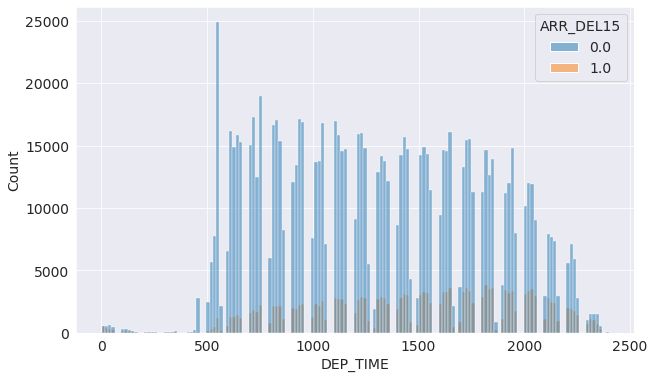

In [19]:
sns.histplot(x = 'DEP_TIME', data = raw_df, hue = 'ARR_DEL15');

In [20]:
px.histogram(raw_df, 
             x='ARR_DEL15', 
             color='DEP_DEL15', 
             title='Rain Tomorrow vs. Rain Today')

In [21]:
raw_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
0,1,2,9E,20363,9E,N8688C,3280,11953,1195302,GNV,10397,1039707,ATL,601.0,0.0,0600-0659,722.0,0.0,0.0,0.0,300.0,NaN
1,1,2,9E,20363,9E,N348PQ,3281,13487,1348702,MSP,11193,1119302,CVG,1359.0,0.0,1400-1459,1633.0,0.0,0.0,0.0,596.0,NaN
2,1,2,9E,20363,9E,N8896A,3282,11433,1143302,DTW,11193,1119302,CVG,1215.0,0.0,1200-1259,1329.0,0.0,0.0,0.0,229.0,NaN
3,1,2,9E,20363,9E,N8886A,3283,15249,1524906,TLH,10397,1039707,ATL,1521.0,0.0,1500-1559,1625.0,0.0,0.0,0.0,223.0,NaN
4,1,2,9E,20363,9E,N8974C,3284,10397,1039707,ATL,11778,1177801,FSM,1847.0,0.0,1900-1959,1940.0,0.0,0.0,0.0,579.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1191326,31,5,9E,20363,9E,N331CA,4812,15412,1541205,TYS,11433,1143302,DTW,1002.0,1.0,0700-0759,1128.0,1.0,0.0,0.0,443.0,NaN
1191327,31,5,9E,20363,9E,N295PQ,4813,11433,1143302,DTW,12478,1247805,JFK,1747.0,0.0,1700-1759,1933.0,0.0,0.0,0.0,509.0,NaN
1191328,31,5,9E,20363,9E,N294PQ,4814,11996,1199603,GSP,12953,1295304,LGA,554.0,0.0,0600-0659,752.0,0.0,0.0,0.0,610.0,NaN
1191329,31,5,9E,20363,9E,N228PQ,4815,10397,1039707,ATL,15919,1591904,XNA,1714.0,0.0,1700-1759,1811.0,0.0,0.0,0.0,589.0,NaN


In [22]:
px.scatter(raw_df.sample(2000), 
           title='Departure Time vs. Arrival Time',
           x='DEP_TIME',
           y='ARR_TIME',
           color='ARR_DEL15')

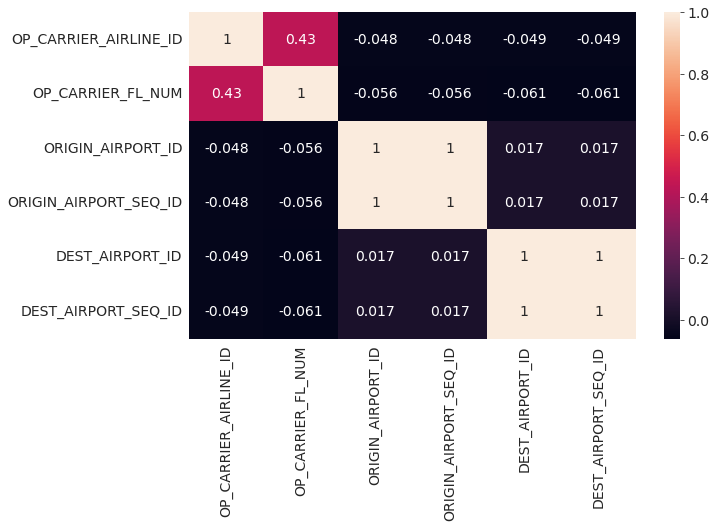

In [23]:
sns.heatmap(raw_df[['OP_CARRIER_AIRLINE_ID', 'OP_CARRIER_FL_NUM', 'ORIGIN_AIRPORT_ID', 
                    'ORIGIN_AIRPORT_SEQ_ID', 'DEST_AIRPORT_ID', 'DEST_AIRPORT_SEQ_ID']].corr(), annot = True )

###Spliting the data into test,Validation and training sets

In [24]:
!pip install scikit-learn --upgrade --quiet

In [25]:
from sklearn.model_selection import train_test_split

In [26]:
train_val_df, test_df = train_test_split(raw_df, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

In [27]:
print('train_df.shape :', train_df.shape)
print('val_df.shape :', val_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (699138, 22)
val_df.shape : (233046, 22)
test_df.shape : (233047, 22)


In [28]:
train_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
1165553,30,4,UA,19977,UA,N445UA,2046,13930,1393007,ORD,11884,1188402,GEG,1943.0,0.0,1900-1959,2127.0,0.0,0.0,0.0,1498.0,NaN
748335,9,4,AA,19805,AA,N932AM,291,11298,1129806,DFW,13204,1320402,MCO,1140.0,0.0,1100-1159,1505.0,0.0,0.0,0.0,985.0,NaN
1153490,30,4,9E,20363,9E,N928XJ,5217,13487,1348702,MSP,10529,1052906,BDL,1236.0,0.0,1200-1259,1609.0,0.0,0.0,0.0,1050.0,NaN
2929,1,2,NK,20416,NK,N527NK,815,13930,1393007,ORD,13495,1349505,MSY,752.0,0.0,0800-0859,1024.0,0.0,0.0,0.0,836.0,NaN
617821,2,4,UA,19977,UA,N890UA,2281,12266,1226603,IAH,12094,1209402,HDN,1154.0,0.0,1100-1159,1337.0,0.0,0.0,0.0,985.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
565818,31,4,OO,20304,OO,N907SW,3842,12156,1215605,HLN,14869,1486903,SLC,1732.0,0.0,1700-1759,1855.0,0.0,0.0,0.0,402.0,NaN
4355,1,2,OO,20304,OO,N213SY,5384,14747,1474703,SEA,12892,1289208,LAX,1234.0,1.0,1200-1259,1504.0,0.0,0.0,0.0,954.0,NaN
227762,13,7,WN,19393,WN,N956WN,3347,12339,1233904,IND,13204,1320402,MCO,1959.0,1.0,1900-1959,2207.0,0.0,0.0,0.0,829.0,NaN
962000,20,1,AA,19805,AA,N561UW,1316,14057,1405702,PDX,11298,1129806,DFW,1202.0,0.0,1200-1259,1731.0,0.0,0.0,0.0,1616.0,NaN


In [29]:
val_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
1164458,30,4,OO,20304,OO,N958SW,5197,13930,1393007,ORD,11337,1133705,DLH,1243.0,0.0,1200-1259,1414.0,0.0,0.0,0.0,397.0,NaN
28495,2,3,YX,20452,YX,N657RW,3606,11540,1154005,ELP,13930,1393007,ORD,643.0,0.0,0600-0659,1101.0,1.0,0.0,0.0,1236.0,NaN
138082,8,2,AA,19805,AA,N908AA,2677,13204,1320402,MCO,11298,1129806,DFW,706.0,0.0,0700-0759,859.0,0.0,0.0,0.0,985.0,NaN
991299,21,2,WN,19393,WN,N417WN,2074,13232,1323202,MDW,10693,1069302,BNA,926.0,0.0,0900-0959,1035.0,0.0,0.0,0.0,395.0,NaN
238168,13,7,OO,20304,OO,N272SY,3799,13930,1393007,ORD,12953,1295304,LGA,1929.0,1.0,1800-1859,2240.0,1.0,0.0,0.0,733.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1043081,24,5,AA,19805,AA,N122US,1131,14100,1410005,PHL,10721,1072102,BOS,1042.0,1.0,0900-0959,1148.0,1.0,0.0,0.0,280.0,NaN
945630,19,7,HA,19690,HA,N479HA,105,13830,1383002,OGG,12173,1217305,HNL,624.0,0.0,0600-0659,700.0,0.0,0.0,0.0,100.0,NaN
249425,14,1,EV,20366,EV,N11551,4054,13422,1342202,MOB,12266,1226603,IAH,920.0,0.0,0900-0959,1047.0,0.0,0.0,0.0,427.0,NaN
868936,15,3,OH,20397,OH,N606NN,5091,11193,1119302,CVG,11057,1105703,CLT,1335.0,0.0,1300-1359,1515.0,0.0,0.0,0.0,335.0,NaN


In [30]:
test_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
376969,21,1,EV,20366,EV,N11192,4115,12266,1226603,IAH,11986,1198603,GRR,1834.0,0.0,1800-1859,2208.0,0.0,0.0,0.0,1042.0,NaN
155525,9,3,YX,20452,YX,N107HQ,4383,11423,1142307,DSM,14100,1410005,PHL,1316.0,0.0,1300-1359,1640.0,0.0,0.0,0.0,972.0,NaN
1059925,25,6,9E,20363,9E,N919XJ,4873,10693,1069302,BNA,12478,1247805,JFK,1340.0,1.0,1200-1259,1703.0,1.0,0.0,0.0,765.0,NaN
222132,12,6,WN,19393,WN,N7714B,3765,13158,1315805,MAF,11259,1125904,DAL,716.0,0.0,0700-0759,818.0,0.0,0.0,0.0,319.0,NaN
105751,6,7,AA,19805,AA,N562UW,639,14679,1467903,SAN,11057,1105703,CLT,1118.0,1.0,1000-1059,1849.0,0.0,0.0,0.0,2077.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199537,11,5,YX,20452,YX,N427YX,4695,13198,1319801,MCI,13303,1330303,MIA,506.0,0.0,0001-0559,901.0,0.0,0.0,0.0,1251.0,NaN
1118588,28,2,WN,19393,WN,N8502Z,2172,13487,1348702,MSP,15016,1501606,STL,629.0,0.0,0600-0659,810.0,0.0,0.0,0.0,448.0,NaN
714506,7,2,YV,20378,YV,N89317,6068,12266,1226603,IAH,12278,1227805,ICT,1324.0,1.0,1200-1259,1517.0,1.0,0.0,0.0,542.0,NaN
358844,20,7,OO,20304,OO,N607SK,3579,11193,1119302,CVG,11433,1143302,DTW,1137.0,0.0,1100-1159,1313.0,1.0,0.0,0.0,229.0,NaN


In [31]:
train_df.describe()

,DAY_OF_MONTH,DAY_OF_WEEK,OP_CARRIER_AIRLINE_ID,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEP_TIME,DEP_DEL15,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
count,699138.000000,699138.000000,699138.000000,699138.000000,699138.000000,6.991380e+05,699138.000000,6.991380e+05,699138.000000,699138.000000,699138.000000,699138.000000,699138.0,699138.0,699138.000000,0.0
mean,15.898326,3.894838,19987.225506,2570.949258,12657.062111,1.265710e+06,12653.381597,1.265342e+06,1332.235423,0.153972,1481.174858,0.161035,0.0,0.0,800.911141,NaN
std,8.997739,1.916637,376.051256,1820.294088,1522.405044,1.522402e+05,1522.768460,1.522766e+05,496.231003,0.360923,524.359630,0.367564,0.0,0.0,590.354180,NaN
min,1.000000,1.000000,19393.000000,1.000000,10135.000000,1.013505e+06,10135.000000,1.013505e+06,1.000000,0.000000,1.000000,0.000000,0.0,0.0,31.000000,NaN
25%,8.000000,2.000000,19790.000000,1018.000000,11292.000000,1.129202e+06,11292.000000,1.129202e+06,920.000000,0.000000,1101.000000,0.000000,0.0,0.0,368.000000,NaN
50%,16.000000,4.000000,19977.000000,2133.000000,12889.000000,1.288903e+06,12889.000000,1.288903e+06,1327.000000,0.000000,1515.000000,0.000000,0.0,0.0,641.000000,NaN
75%,24.000000,5.000000,20368.000000,3998.000000,14027.000000,1.402702e+06,14027.000000,1.402702e+06,1739.000000,0.000000,1919.000000,0.000000,0.0,0.0,1042.000000,NaN
max,31.000000,7.000000,20452.000000,7439.000000,16869.000000,1.686901e+06,16869.000000,1.686901e+06,2400.000000,1.000000,2400.000000,1.000000,0.0,0.0,5095.000000,NaN


In [32]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 699138 entries, 1165553 to 916558
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   DAY_OF_MONTH           699138 non-null  int64  
 1   DAY_OF_WEEK            699138 non-null  int64  
 2   OP_UNIQUE_CARRIER      699138 non-null  object 
 3   OP_CARRIER_AIRLINE_ID  699138 non-null  int64  
 4   OP_CARRIER             699138 non-null  object 
 5   TAIL_NUM               699138 non-null  object 
 6   OP_CARRIER_FL_NUM      699138 non-null  int64  
 7   ORIGIN_AIRPORT_ID      699138 non-null  int64  
 8   ORIGIN_AIRPORT_SEQ_ID  699138 non-null  int64  
 9   ORIGIN                 699138 non-null  object 
 10  DEST_AIRPORT_ID        699138 non-null  int64  
 11  DEST_AIRPORT_SEQ_ID    699138 non-null  int64  
 12  DEST                   699138 non-null  object 
 13  DEP_TIME               699138 non-null  float64
 14  DEP_DEL15              699138 

In [33]:
val_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 233046 entries, 1164458 to 488954
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   DAY_OF_MONTH           233046 non-null  int64  
 1   DAY_OF_WEEK            233046 non-null  int64  
 2   OP_UNIQUE_CARRIER      233046 non-null  object 
 3   OP_CARRIER_AIRLINE_ID  233046 non-null  int64  
 4   OP_CARRIER             233046 non-null  object 
 5   TAIL_NUM               233046 non-null  object 
 6   OP_CARRIER_FL_NUM      233046 non-null  int64  
 7   ORIGIN_AIRPORT_ID      233046 non-null  int64  
 8   ORIGIN_AIRPORT_SEQ_ID  233046 non-null  int64  
 9   ORIGIN                 233046 non-null  object 
 10  DEST_AIRPORT_ID        233046 non-null  int64  
 11  DEST_AIRPORT_SEQ_ID    233046 non-null  int64  
 12  DEST                   233046 non-null  object 
 13  DEP_TIME               233046 non-null  float64
 14  DEP_DEL15              233046 

In [34]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 233047 entries, 376969 to 599522
Data columns (total 22 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   DAY_OF_MONTH           233047 non-null  int64  
 1   DAY_OF_WEEK            233047 non-null  int64  
 2   OP_UNIQUE_CARRIER      233047 non-null  object 
 3   OP_CARRIER_AIRLINE_ID  233047 non-null  int64  
 4   OP_CARRIER             233047 non-null  object 
 5   TAIL_NUM               233047 non-null  object 
 6   OP_CARRIER_FL_NUM      233047 non-null  int64  
 7   ORIGIN_AIRPORT_ID      233047 non-null  int64  
 8   ORIGIN_AIRPORT_SEQ_ID  233047 non-null  int64  
 9   ORIGIN                 233047 non-null  object 
 10  DEST_AIRPORT_ID        233047 non-null  int64  
 11  DEST_AIRPORT_SEQ_ID    233047 non-null  int64  
 12  DEST                   233047 non-null  object 
 13  DEP_TIME               233047 non-null  float64
 14  DEP_DEL15              233047 n

In [35]:
print(train_df.columns)


Index(['DAY_OF_MONTH', 'DAY_OF_WEEK', 'OP_UNIQUE_CARRIER',
       'OP_CARRIER_AIRLINE_ID', 'OP_CARRIER', 'TAIL_NUM', 'OP_CARRIER_FL_NUM',
       'ORIGIN_AIRPORT_ID', 'ORIGIN_AIRPORT_SEQ_ID', 'ORIGIN',
       'DEST_AIRPORT_ID', 'DEST_AIRPORT_SEQ_ID', 'DEST', 'DEP_TIME',
       'DEP_DEL15', 'DEP_TIME_BLK', 'ARR_TIME', 'ARR_DEL15', 'CANCELLED',
       'DIVERTED', 'DISTANCE', 'Unnamed: 21'],
      dtype='object')


In [36]:
train_df.head(2)

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
1165553,30,4,UA,19977,UA,N445UA,2046,13930,1393007,ORD,11884,1188402,GEG,1943.0,0.0,1900-1959,2127.0,0.0,0.0,0.0,1498.0,NaN
748335,9,4,AA,19805,AA,N932AM,291,11298,1129806,DFW,13204,1320402,MCO,1140.0,0.0,1100-1159,1505.0,0.0,0.0,0.0,985.0,NaN


In [37]:
raw_df.nunique()

DAY_OF_MONTH               31
DAY_OF_WEEK                 7
OP_UNIQUE_CARRIER          17
OP_CARRIER_AIRLINE_ID      17
OP_CARRIER                 17
TAIL_NUM                 5854
OP_CARRIER_FL_NUM        6997
ORIGIN_AIRPORT_ID         353
ORIGIN_AIRPORT_SEQ_ID     373
ORIGIN                    353
DEST_AIRPORT_ID           353
DEST_AIRPORT_SEQ_ID       373
DEST                      353
DEP_TIME                 1440
DEP_DEL15                   2
DEP_TIME_BLK               19
ARR_TIME                 1440
ARR_DEL15                   2
CANCELLED                   1
DIVERTED                    1
DISTANCE                 1511
Unnamed: 21                 0
dtype: int64

In [38]:
input_cols=['DAY_OF_MONTH','DAY_OF_WEEK','OP_CARRIER','DEP_TIME','DEP_DEL15','DEP_TIME_BLK','DISTANCE',]
target_cols='ARR_DEL15'

In [39]:
numeric_cols =  ['DAY_OF_MONTH','DEP_TIME', 'DISTANCE']
categorical_cols =  ['DAY_OF_WEEK', 'OP_CARRIER', 'DEP_DEL15', 'DEP_TIME_BLK']

In [40]:
train_df[numeric_cols].describe()

,DAY_OF_MONTH,DEP_TIME,DISTANCE
count,699138.000000,699138.000000,699138.000000
mean,15.898326,1332.235423,800.911141
std,8.997739,496.231003,590.354180
min,1.000000,1.000000,31.000000
25%,8.000000,920.000000,368.000000
50%,16.000000,1327.000000,641.000000
75%,24.000000,1739.000000,1042.000000
max,31.000000,2400.000000,5095.000000


In [41]:
train_df

,DAY_OF_MONTH,DAY_OF_WEEK,OP_UNIQUE_CARRIER,OP_CARRIER_AIRLINE_ID,OP_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN_AIRPORT_ID,ORIGIN_AIRPORT_SEQ_ID,ORIGIN,DEST_AIRPORT_ID,DEST_AIRPORT_SEQ_ID,DEST,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,ARR_TIME,ARR_DEL15,CANCELLED,DIVERTED,DISTANCE,Unnamed: 21
1165553,30,4,UA,19977,UA,N445UA,2046,13930,1393007,ORD,11884,1188402,GEG,1943.0,0.0,1900-1959,2127.0,0.0,0.0,0.0,1498.0,NaN
748335,9,4,AA,19805,AA,N932AM,291,11298,1129806,DFW,13204,1320402,MCO,1140.0,0.0,1100-1159,1505.0,0.0,0.0,0.0,985.0,NaN
1153490,30,4,9E,20363,9E,N928XJ,5217,13487,1348702,MSP,10529,1052906,BDL,1236.0,0.0,1200-1259,1609.0,0.0,0.0,0.0,1050.0,NaN
2929,1,2,NK,20416,NK,N527NK,815,13930,1393007,ORD,13495,1349505,MSY,752.0,0.0,0800-0859,1024.0,0.0,0.0,0.0,836.0,NaN
617821,2,4,UA,19977,UA,N890UA,2281,12266,1226603,IAH,12094,1209402,HDN,1154.0,0.0,1100-1159,1337.0,0.0,0.0,0.0,985.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
565818,31,4,OO,20304,OO,N907SW,3842,12156,1215605,HLN,14869,1486903,SLC,1732.0,0.0,1700-1759,1855.0,0.0,0.0,0.0,402.0,NaN
4355,1,2,OO,20304,OO,N213SY,5384,14747,1474703,SEA,12892,1289208,LAX,1234.0,1.0,1200-1259,1504.0,0.0,0.0,0.0,954.0,NaN
227762,13,7,WN,19393,WN,N956WN,3347,12339,1233904,IND,13204,1320402,MCO,1959.0,1.0,1900-1959,2207.0,0.0,0.0,0.0,829.0,NaN
962000,20,1,AA,19805,AA,N561UW,1316,14057,1405702,PDX,11298,1129806,DFW,1202.0,0.0,1200-1259,1731.0,0.0,0.0,0.0,1616.0,NaN


In [42]:
train_df[input_cols]

,DAY_OF_MONTH,DAY_OF_WEEK,OP_CARRIER,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,DISTANCE
1165553,30,4,UA,1943.0,0.0,1900-1959,1498.0
748335,9,4,AA,1140.0,0.0,1100-1159,985.0
1153490,30,4,9E,1236.0,0.0,1200-1259,1050.0
2929,1,2,NK,752.0,0.0,0800-0859,836.0
617821,2,4,UA,1154.0,0.0,1100-1159,985.0
...,...,...,...,...,...,...,...
565818,31,4,OO,1732.0,0.0,1700-1759,402.0
4355,1,2,OO,1234.0,1.0,1200-1259,954.0
227762,13,7,WN,1959.0,1.0,1900-1959,829.0
962000,20,1,AA,1202.0,0.0,1200-1259,1616.0


In [43]:
train_inputs = train_df[input_cols].copy()
val_inputs = val_df[input_cols].copy()
test_inputs = test_df[input_cols].copy()

In [44]:
train_targets = train_df[target_cols].copy()
val_targets = val_df[target_cols].copy()
test_targets = test_df[target_cols].copy()

In [45]:
train_inputs

,DAY_OF_MONTH,DAY_OF_WEEK,OP_CARRIER,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,DISTANCE
1165553,30,4,UA,1943.0,0.0,1900-1959,1498.0
748335,9,4,AA,1140.0,0.0,1100-1159,985.0
1153490,30,4,9E,1236.0,0.0,1200-1259,1050.0
2929,1,2,NK,752.0,0.0,0800-0859,836.0
617821,2,4,UA,1154.0,0.0,1100-1159,985.0
...,...,...,...,...,...,...,...
565818,31,4,OO,1732.0,0.0,1700-1759,402.0
4355,1,2,OO,1234.0,1.0,1200-1259,954.0
227762,13,7,WN,1959.0,1.0,1900-1959,829.0
962000,20,1,AA,1202.0,0.0,1200-1259,1616.0


In [46]:
train_inputs[categorical_cols].nunique()

DAY_OF_WEEK      7
OP_CARRIER      17
DEP_DEL15        2
DEP_TIME_BLK    19
dtype: int64

###Imputation

In [47]:
raw_df.isna().sum()

DAY_OF_MONTH                   0
DAY_OF_WEEK                    0
OP_UNIQUE_CARRIER              0
OP_CARRIER_AIRLINE_ID          0
OP_CARRIER                     0
TAIL_NUM                       0
OP_CARRIER_FL_NUM              0
ORIGIN_AIRPORT_ID              0
ORIGIN_AIRPORT_SEQ_ID          0
ORIGIN                         0
DEST_AIRPORT_ID                0
DEST_AIRPORT_SEQ_ID            0
DEST                           0
DEP_TIME                       0
DEP_DEL15                      0
DEP_TIME_BLK                   0
ARR_TIME                       0
ARR_DEL15                      0
CANCELLED                      0
DIVERTED                       0
DISTANCE                       0
Unnamed: 21              1165231
dtype: int64

###Scaling Numeric Value

In [48]:
from sklearn.preprocessing import MinMaxScaler

In [49]:
scaler = MinMaxScaler()

In [50]:
scaler.fit(raw_df[numeric_cols])

MinMaxScaler()

In [51]:
print('Minimum:')
list(scaler.data_min_)

Minimum:


[1.0, 1.0, 31.0]

In [52]:
print('Maximum:')
list(scaler.data_max_)

Maximum:


[31.0, 2400.0, 5095.0]

In [53]:
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [54]:
train_inputs[numeric_cols].describe()

,DAY_OF_MONTH,DEP_TIME,DISTANCE
count,699138.000000,699138.000000,699138.000000
mean,0.496611,0.554913,0.152036
std,0.299925,0.206849,0.116579
min,0.000000,0.000000,0.000000
25%,0.233333,0.383076,0.066548
50%,0.500000,0.552730,0.120458
75%,0.766667,0.724469,0.199645
max,1.000000,1.000000,1.000000


###Encoding Categorical Columns

In [55]:
from sklearn.preprocessing import OneHotEncoder

In [56]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')

In [57]:
encoder.fit(raw_df[categorical_cols])

OneHotEncoder(handle_unknown='ignore', sparse=False)

In [58]:
encoder.categories_

[array([1, 2, 3, 4, 5, 6, 7]),
 array(['9E', 'AA', 'AS', 'B6', 'DL', 'EV', 'F9', 'G4', 'HA', 'MQ', 'NK',
        'OH', 'OO', 'UA', 'WN', 'YV', 'YX'], dtype=object),
 array([0., 1.]),
 array(['0001-0559', '0600-0659', '0700-0759', '0800-0859', '0900-0959',
        '1000-1059', '1100-1159', '1200-1259', '1300-1359', '1400-1459',
        '1500-1559', '1600-1659', '1700-1759', '1800-1859', '1900-1959',
        '2000-2059', '2100-2159', '2200-2259', '2300-2359'], dtype=object)]

In [59]:
encoded_cols = list(encoder.get_feature_names(categorical_cols))
print(encoded_cols)

['DAY_OF_WEEK_1', 'DAY_OF_WEEK_2', 'DAY_OF_WEEK_3', 'DAY_OF_WEEK_4', 'DAY_OF_WEEK_5', 'DAY_OF_WEEK_6', 'DAY_OF_WEEK_7', 'OP_CARRIER_9E', 'OP_CARRIER_AA', 'OP_CARRIER_AS', 'OP_CARRIER_B6', 'OP_CARRIER_DL', 'OP_CARRIER_EV', 'OP_CARRIER_F9', 'OP_CARRIER_G4', 'OP_CARRIER_HA', 'OP_CARRIER_MQ', 'OP_CARRIER_NK', 'OP_CARRIER_OH', 'OP_CARRIER_OO', 'OP_CARRIER_UA', 'OP_CARRIER_WN', 'OP_CARRIER_YV', 'OP_CARRIER_YX', 'DEP_DEL15_0.0', 'DEP_DEL15_1.0', 'DEP_TIME_BLK_0001-0559', 'DEP_TIME_BLK_0600-0659', 'DEP_TIME_BLK_0700-0759', 'DEP_TIME_BLK_0800-0859', 'DEP_TIME_BLK_0900-0959', 'DEP_TIME_BLK_1000-1059', 'DEP_TIME_BLK_1100-1159', 'DEP_TIME_BLK_1200-1259', 'DEP_TIME_BLK_1300-1359', 'DEP_TIME_BLK_1400-1459', 'DEP_TIME_BLK_1500-1559', 'DEP_TIME_BLK_1600-1659', 'DEP_TIME_BLK_1700-1759', 'DEP_TIME_BLK_1800-1859', 'DEP_TIME_BLK_1900-1959', 'DEP_TIME_BLK_2000-2059', 'DEP_TIME_BLK_2100-2159', 'DEP_TIME_BLK_2200-2259', 'DEP_TIME_BLK_2300-2359']


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.



In [60]:
len(encoded_cols)

45

In [61]:
train_inputs[encoded_cols] = encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols] = encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols] = encoder.transform(test_inputs[categorical_cols])

In [62]:
test_inputs

,DAY_OF_MONTH,DAY_OF_WEEK,OP_CARRIER,DEP_TIME,DEP_DEL15,DEP_TIME_BLK,DISTANCE,DAY_OF_WEEK_1,DAY_OF_WEEK_2,DAY_OF_WEEK_3,DAY_OF_WEEK_4,DAY_OF_WEEK_5,DAY_OF_WEEK_6,DAY_OF_WEEK_7,OP_CARRIER_9E,OP_CARRIER_AA,OP_CARRIER_AS,OP_CARRIER_B6,OP_CARRIER_DL,OP_CARRIER_EV,OP_CARRIER_F9,OP_CARRIER_G4,OP_CARRIER_HA,OP_CARRIER_MQ,OP_CARRIER_NK,OP_CARRIER_OH,OP_CARRIER_OO,OP_CARRIER_UA,OP_CARRIER_WN,OP_CARRIER_YV,OP_CARRIER_YX,DEP_DEL15_0.0,DEP_DEL15_1.0,DEP_TIME_BLK_0001-0559,DEP_TIME_BLK_0600-0659,DEP_TIME_BLK_0700-0759,DEP_TIME_BLK_0800-0859,DEP_TIME_BLK_0900-0959,DEP_TIME_BLK_1000-1059,DEP_TIME_BLK_1100-1159,DEP_TIME_BLK_1200-1259,DEP_TIME_BLK_1300-1359,DEP_TIME_BLK_1400-1459,DEP_TIME_BLK_1500-1559,DEP_TIME_BLK_1600-1659,DEP_TIME_BLK_1700-1759,DEP_TIME_BLK_1800-1859,DEP_TIME_BLK_1900-1959,DEP_TIME_BLK_2000-2059,DEP_TIME_BLK_2100-2159,DEP_TIME_BLK_2200-2259,DEP_TIME_BLK_2300-2359
376969,0.666667,1,EV,0.764068,0.0,1800-1859,0.199645,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
155525,0.266667,3,YX,0.548145,0.0,1300-1359,0.185821,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1059925,0.800000,6,9E,0.558149,1.0,1200-1259,0.144945,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
222132,0.366667,6,WN,0.298041,0.0,0700-0759,0.056872,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
105751,0.166667,7,AA,0.465611,1.0,1000-1059,0.404028,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199537,0.333333,5,YX,0.210504,0.0,0001-0559,0.240916,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1118588,0.900000,2,WN,0.261776,0.0,0600-0659,0.082346,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
714506,0.200000,2,YV,0.551480,1.0,1200-1259,0.100908,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
358844,0.633333,7,OO,0.473531,0.0,1100-1159,0.039100,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [63]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [64]:
X_train

,DAY_OF_MONTH,DEP_TIME,DISTANCE,DAY_OF_WEEK_1,DAY_OF_WEEK_2,DAY_OF_WEEK_3,DAY_OF_WEEK_4,DAY_OF_WEEK_5,DAY_OF_WEEK_6,DAY_OF_WEEK_7,OP_CARRIER_9E,OP_CARRIER_AA,OP_CARRIER_AS,OP_CARRIER_B6,OP_CARRIER_DL,OP_CARRIER_EV,OP_CARRIER_F9,OP_CARRIER_G4,OP_CARRIER_HA,OP_CARRIER_MQ,OP_CARRIER_NK,OP_CARRIER_OH,OP_CARRIER_OO,OP_CARRIER_UA,OP_CARRIER_WN,OP_CARRIER_YV,OP_CARRIER_YX,DEP_DEL15_0.0,DEP_DEL15_1.0,DEP_TIME_BLK_0001-0559,DEP_TIME_BLK_0600-0659,DEP_TIME_BLK_0700-0759,DEP_TIME_BLK_0800-0859,DEP_TIME_BLK_0900-0959,DEP_TIME_BLK_1000-1059,DEP_TIME_BLK_1100-1159,DEP_TIME_BLK_1200-1259,DEP_TIME_BLK_1300-1359,DEP_TIME_BLK_1400-1459,DEP_TIME_BLK_1500-1559,DEP_TIME_BLK_1600-1659,DEP_TIME_BLK_1700-1759,DEP_TIME_BLK_1800-1859,DEP_TIME_BLK_1900-1959,DEP_TIME_BLK_2000-2059,DEP_TIME_BLK_2100-2159,DEP_TIME_BLK_2200-2259,DEP_TIME_BLK_2300-2359
1165553,0.966667,0.809504,0.289692,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
748335,0.266667,0.474781,0.188389,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1153490,0.966667,0.514798,0.201224,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2929,0.000000,0.313047,0.158965,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
617821,0.033333,0.480617,0.188389,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
565818,1.000000,0.721551,0.073262,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4355,0.000000,0.513964,0.182267,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
227762,0.400000,0.816173,0.157583,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
962000,0.633333,0.500625,0.312994,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


##Model for Prediction



In [65]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_auc_score

Here we will asses performance of models by accuracy_score (how accurate is the model in predicting classes correctly against its labels) and roc_auc_score (which is the are under Receiver Operating Characteristic Curve (ROC AUC) from prediction scores). This roc_auc_score measures separability of classes, that is how well the model is distinguishing classes. A maximum value for this score of 1 indicates model is perfectly distinguishing classes and a min 0 indicates model is worst. For datasets like the current one with different proportion of positive and negative classes, this metric is a very good estimate of models. our aim will be to maximize both accuracy_score and roc_auc_score.

In [66]:
# function to check performance of a model
def model_performance(model, X_train, y_train, X_val, y_val):
  model.fit(X_train, y_train)
  train_preds = model.predict(X_train)
  val_preds = model.predict(X_val)
  train_accuracy = accuracy_score(y_train, train_preds)
  val_accuracy = accuracy_score(y_val, val_preds)
  print('Train set accuracy: {:.2f}%'.format(train_accuracy*100))
  print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
  print('Validation Classification report: \n', classification_report(y_val, val_preds))
  print('roc auc score: {:.2f}'.format(roc_auc_score(y_val, val_preds)))  
  conf_matrix =  confusion_matrix(y_val, val_preds, normalize = 'true')
  plt.figure()
  plt.title('Validation Confusion Matrix')
  sns.heatmap(conf_matrix, annot = True)

#Logistic Regression

In [67]:
from sklearn.linear_model import LogisticRegression

In [68]:
model_lr = LogisticRegression(solver = 'liblinear', random_state = 42)

Train set accuracy: 92.36%
Validation set Accuracy: 92.28%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.95    195477
         1.0       0.77      0.74      0.76     37569

    accuracy                           0.92    233046
   macro avg       0.86      0.85      0.85    233046
weighted avg       0.92      0.92      0.92    233046

roc auc score: 0.85


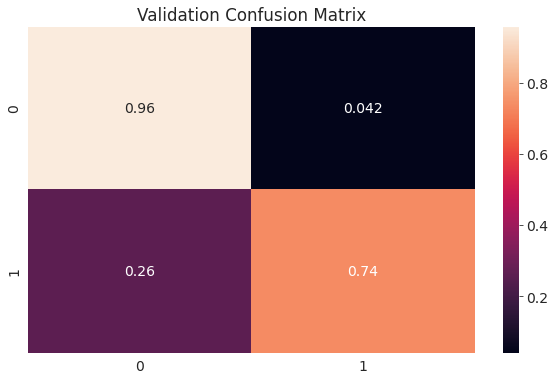

In [69]:
model_performance(model_lr, X_train, train_targets, X_val, val_targets)


###Comparing with a dumb model



The basic logistic regression model is able to give an accuracy of 92.28% on validation set. Let's compare this performance with a dump model.



In [70]:
# dump model
def all_ok_model(inputs):
  return np.full(len(inputs), 0)

In [71]:
print('Dump model Validation Accuracy: {:.2f}%'.format(accuracy_score(all_ok_model(val_targets), val_targets)*100))

Dump model Validation Accuracy: 83.88%


Logistic Regression's validation accuracy is much better thatn dump model's validation accuracy of 83.88%.

##Hyperparameter tuning for Logistic Regression

In [72]:
# function to quickly evaluate effect of different hyperparameters
def test_params_lr(**params):
    model = LogisticRegression(random_state=42, **params).fit(X_train, train_targets)
    train_accuracy = model.score(X_train, train_targets)
    val_accuracy = model.score(X_val, val_targets)
    roc_auc_score_lr = roc_auc_score(val_targets, model.predict(X_val))
    print('Train set accuracy: {:.2f}%'.format(train_accuracy*100))
    print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
    print('roc auc score: {:.2f}'.format(roc_auc_score_lr)) 

In [73]:
test_params_lr(solver = 'sag')

Train set accuracy: 92.36%
Validation set Accuracy: 92.28%
roc auc score: 0.85


In [74]:
test_params_lr(max_iter = 500, solver = 'lbfgs') #not coverged in 100 iterations

Train set accuracy: 92.36%
Validation set Accuracy: 92.28%
roc auc score: 0.85


In [75]:
test_params_lr(max_iter = 250, solver = 'liblinear')

Train set accuracy: 92.36%
Validation set Accuracy: 92.28%
roc auc score: 0.85


In [76]:
test_params_lr(max_iter = 1000, solver = 'liblinear')

Train set accuracy: 92.36%
Validation set Accuracy: 92.28%
roc auc score: 0.85


No,improvement is seen by changing the hyperparameters 

#Decision Tree Classification

In [77]:
from sklearn.tree import DecisionTreeClassifier

In [78]:
model_dtc = DecisionTreeClassifier(random_state=42)

In [79]:
%%time
model_dtc.fit(X_train, train_targets)

CPU times: user 10.8 s, sys: 12.8 ms, total: 10.8 s
Wall time: 10.7 s


DecisionTreeClassifier(random_state=42)

Evaluation


In [80]:
from sklearn.metrics import accuracy_score, confusion_matrix

In [81]:
train_preds = model_dtc.predict(X_train)

In [82]:
train_preds

array([0., 0., 0., ..., 0., 0., 0.])

In [83]:
pd.value_counts(train_preds)

0.0    586623
1.0    112515
dtype: int64

In [84]:
train_probs = model_dtc.predict_proba(X_train)

In [85]:
train_probs

array([[1., 0.],
       [1., 0.],
       [1., 0.],
       ...,
       [1., 0.],
       [1., 0.],
       [1., 0.]])

In [86]:
accuracy_score(train_targets, train_preds)

0.999898446372533

In [87]:
model_dtc.score(X_val, val_targets)

0.881740085648327

Train set accuracy: 99.99%
Validation set Accuracy: 88.17%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.93      0.93      0.93    195477
         1.0       0.63      0.65      0.64     37569

    accuracy                           0.88    233046
   macro avg       0.78      0.79      0.78    233046
weighted avg       0.88      0.88      0.88    233046

roc auc score: 0.79


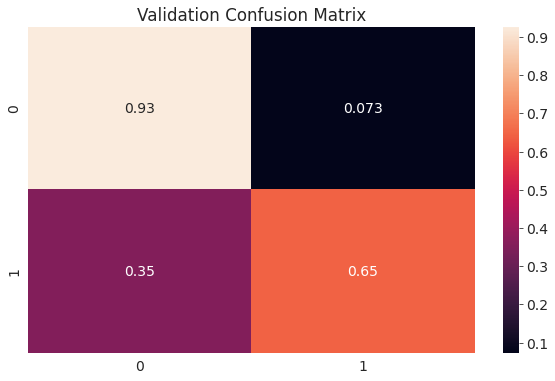

In [88]:
model_performance(model_dtc, X_train, train_targets, X_val, val_targets)

In [89]:
val_targets.value_counts() / len(val_targets)

0.0    0.838791
1.0    0.161209
Name: ARR_DEL15, dtype: float64

##Visualizaton

In [90]:
from sklearn.tree import plot_tree, export_text

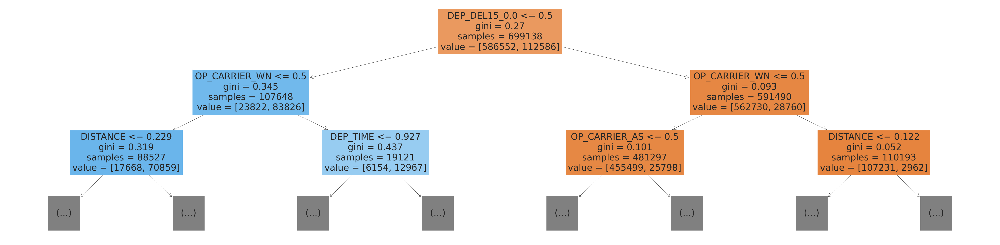

In [91]:
plt.figure(figsize=(80,20))
plot_tree(model_dtc, feature_names=X_train.columns, max_depth=2, filled=True);

In [92]:
model_dtc.tree_.max_depth

61

In [93]:
tree_text = export_text(model_dtc, max_depth=10, feature_names=list(X_train.columns))
print(tree_text[:5000])

|--- DEP_DEL15_0.0 <= 0.50
|   |--- OP_CARRIER_WN <= 0.50
|   |   |--- DISTANCE <= 0.23
|   |   |   |--- OP_CARRIER_DL <= 0.50
|   |   |   |   |--- DEP_TIME <= 0.88
|   |   |   |   |   |--- DISTANCE <= 0.15
|   |   |   |   |   |   |--- DEP_TIME_BLK_2000-2059 <= 0.50
|   |   |   |   |   |   |   |--- DEP_TIME <= 0.84
|   |   |   |   |   |   |   |   |--- DEP_TIME_BLK_1900-1959 <= 0.50
|   |   |   |   |   |   |   |   |   |--- DEP_TIME <= 0.80
|   |   |   |   |   |   |   |   |   |   |--- DEP_TIME_BLK_1800-1859 <= 0.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 47
|   |   |   |   |   |   |   |   |   |   |--- DEP_TIME_BLK_1800-1859 >  0.50
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 26
|   |   |   |   |   |   |   |   |   |--- DEP_TIME >  0.80
|   |   |   |   |   |   |   |   |   |   |--- DEP_TIME <= 0.80
|   |   |   |   |   |   |   |   |   |   |   |--- truncated branch of depth 14
|   |   |   |   |   |   |   |   |   |   |--- DEP_TI

In [94]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model_dtc.feature_importances_
}).sort_values('importance', ascending=False)

In [95]:
importance_df

,feature,importance
27,DEP_DEL15_0.0,0.514125
1,DEP_TIME,0.173284
2,DISTANCE,0.141939
0,DAY_OF_MONTH,0.053339
6,DAY_OF_WEEK_4,0.006650
7,DAY_OF_WEEK_5,0.006113
5,DAY_OF_WEEK_3,0.006079
3,DAY_OF_WEEK_1,0.005713
9,DAY_OF_WEEK_7,0.005471
4,DAY_OF_WEEK_2,0.005441


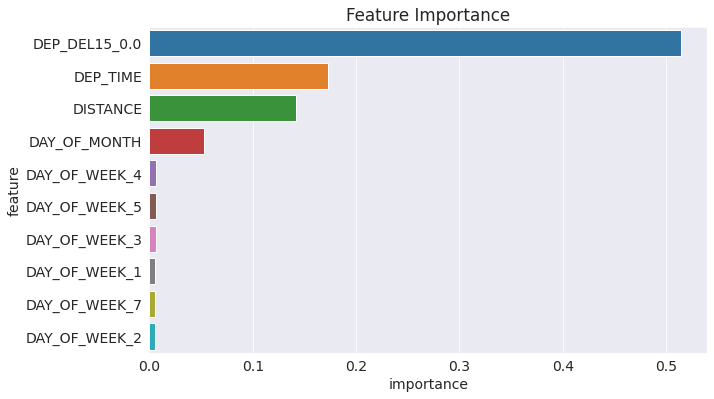

In [96]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

###Hyperparameter tuning for Decision Tree Classifier

Max_depth

In [97]:
model_dtc = DecisionTreeClassifier(max_depth=3, random_state=42)

In [98]:
model_dtc.fit(X_train, train_targets)

DecisionTreeClassifier(max_depth=3, random_state=42)

In [99]:
model_dtc.score(X_train, train_targets)

0.9247902416976334

In [100]:
model_dtc.score(X_val, val_targets)

0.924087948302052

In [101]:
roc_auc_score(val_targets, model_dtc.predict(X_val))

0.8522598750001426

In [102]:
model_dtc.classes_

array([0., 1.])

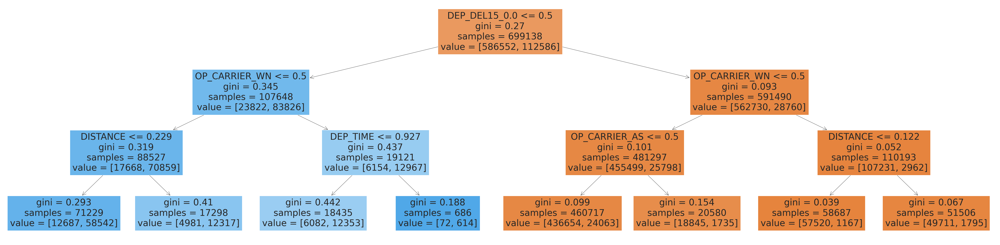

In [103]:
plt.figure(figsize=(80,20))
plot_tree(model_dtc, feature_names=X_train.columns, max_depth=4, filled=True);

In [104]:
print(export_text(model_dtc, feature_names=list(X_train.columns)))

|--- DEP_DEL15_0.0 <= 0.50
|   |--- OP_CARRIER_WN <= 0.50
|   |   |--- DISTANCE <= 0.23
|   |   |   |--- class: 1.0
|   |   |--- DISTANCE >  0.23
|   |   |   |--- class: 1.0
|   |--- OP_CARRIER_WN >  0.50
|   |   |--- DEP_TIME <= 0.93
|   |   |   |--- class: 1.0
|   |   |--- DEP_TIME >  0.93
|   |   |   |--- class: 1.0
|--- DEP_DEL15_0.0 >  0.50
|   |--- OP_CARRIER_WN <= 0.50
|   |   |--- OP_CARRIER_AS <= 0.50
|   |   |   |--- class: 0.0
|   |   |--- OP_CARRIER_AS >  0.50
|   |   |   |--- class: 0.0
|   |--- OP_CARRIER_WN >  0.50
|   |   |--- DISTANCE <= 0.12
|   |   |   |--- class: 0.0
|   |   |--- DISTANCE >  0.12
|   |   |   |--- class: 0.0



In [105]:
def max_depth_error(md):
    model = DecisionTreeClassifier(max_depth=md, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    val_acc = 1 - model.score(X_val, val_targets)
    return {'Max Depth': md, 'Training Error': train_acc, 'Validation Error': val_acc}

In [106]:
%%time
errors_df = pd.DataFrame([max_depth_error(md) for md in range(1, 21)])

CPU times: user 1min 55s, sys: 338 ms, total: 1min 56s
Wall time: 1min 56s


In [107]:
errors_df

,Max Depth,Training Error,Validation Error
0,1,0.075210,0.075912
1,2,0.075210,0.075912
2,3,0.075210,0.075912
3,4,0.075210,0.075912
4,5,0.075158,0.075916
5,6,0.075080,0.075809
6,7,0.074944,0.075873
7,8,0.074606,0.075745
8,9,0.074251,0.075861
9,10,0.073659,0.075766


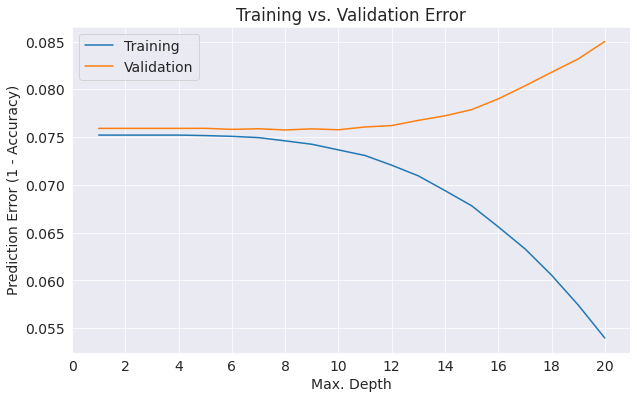

In [108]:
plt.figure()
plt.plot(errors_df['Max Depth'], errors_df['Training Error'])
plt.plot(errors_df['Max Depth'], errors_df['Validation Error'])
plt.title('Training vs. Validation Error')
plt.xticks(range(0,21, 2))
plt.xlabel('Max. Depth')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

From above error_df and by graph, max_depth =7 will be appropriate depth of Decision Tree and model is not overfitting

*   List item
*   List item



In [109]:
#creating a function to quickly evaluate effect of different hyperparameters
def test_params_dtc(**params):
    model = DecisionTreeClassifier(random_state=42, **params).fit(X_train, train_targets)
    train_accuracy = model.score(X_train, train_targets)
    val_accuracy = model.score(X_val, val_targets)
    roc_auc_score_lr = roc_auc_score(val_targets, model.predict(X_val))
    print('Train set accuracy: {:.2f}%'.format(train_accuracy*100))
    print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
    print('roc auc score: {:.2f}'.format(roc_auc_score_lr))

In [110]:
test_params_dtc(max_depth=7)

Train set accuracy: 92.51%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [111]:
test_params_dtc(max_depth=8)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [112]:
test_params_dtc(max_depth=9)

Train set accuracy: 92.57%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [113]:
test_params_dtc(max_depth=10)

Train set accuracy: 92.63%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [114]:
test_params_dtc(max_depth=11)

Train set accuracy: 92.69%
Validation set Accuracy: 92.39%
roc auc score: 0.85


we can observe there is not much difference in accuracy for max_depth=8 and max_depth =2 but after after max_depth >8 may lead to overfitting

Max_leaf_nodes

In [115]:
test_params_dtc(max_leaf_nodes = 64)

Train set accuracy: 92.49%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [116]:
test_params_dtc(max_leaf_nodes = 128)

Train set accuracy: 92.55%
Validation set Accuracy: 92.44%
roc auc score: 0.85


In [117]:
test_params_dtc(max_leaf_nodes = 256)

Train set accuracy: 92.65%
Validation set Accuracy: 92.49%
roc auc score: 0.84


In [118]:
test_params_dtc(max_leaf_nodes=512)

Train set accuracy: 92.79%
Validation set Accuracy: 92.50%
roc auc score: 0.84


In [119]:
test_params_dtc(max_leaf_nodes=600)

Train set accuracy: 92.86%
Validation set Accuracy: 92.53%
roc auc score: 0.84


In [120]:
test_params_dtc(max_leaf_nodes=700)

Train set accuracy: 92.90%
Validation set Accuracy: 92.54%
roc auc score: 0.84


In [121]:
test_params_dtc(max_leaf_nodes=800)

Train set accuracy: 92.95%
Validation set Accuracy: 92.52%
roc auc score: 0.83


max_leaf_nodes=700 can be used for the model

In [122]:
def max_leaf_nodes_error(mn):
    model = DecisionTreeClassifier(max_leaf_nodes=mn, random_state=42)
    model.fit(X_train, train_targets)
    train_acc = 1 - model.score(X_train, train_targets)
    val_acc = 1 - model.score(X_val, val_targets)
    return {'Max leaf nodes': mn, 'Training Error': train_acc, 'Validation Error': val_acc}

In [123]:
%%time
errors_df = pd.DataFrame([max_leaf_nodes_error(mn) for mn in range(10, 1000,100)])

CPU times: user 59.3 s, sys: 96.1 ms, total: 59.4 s
Wall time: 59.1 s


In [124]:
errors_df

,Max leaf nodes,Training Error,Validation Error
0,10,0.075210,0.075912
1,110,0.074565,0.075642
2,210,0.073963,0.075191
3,310,0.073093,0.074942
4,410,0.072594,0.074882
5,510,0.072067,0.074981
6,610,0.071389,0.074702
7,710,0.070973,0.074625
8,810,0.070500,0.074758
9,910,0.070101,0.074895


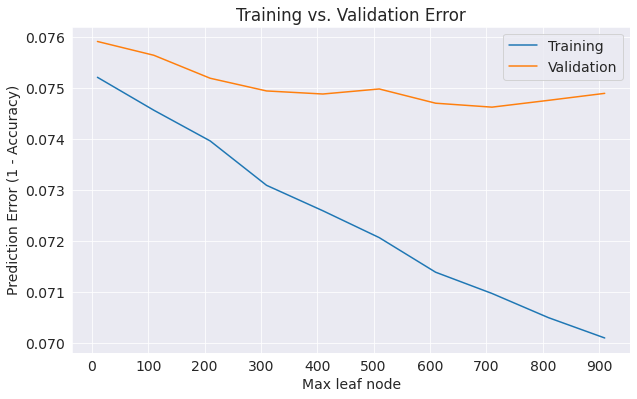

In [125]:
plt.figure()
plt.plot(errors_df['Max leaf nodes'], errors_df['Training Error'])
plt.plot(errors_df['Max leaf nodes'], errors_df['Validation Error'])
plt.title('Training vs. Validation Error')
plt.xticks(range(0,1000, 100))
plt.xlabel('Max leaf node')
plt.ylabel('Prediction Error (1 - Accuracy)')
plt.legend(['Training', 'Validation'])

We can also check for some values for min_samples_split and min_samples_leaf.

In [126]:
test_params_dtc(max_depth = 8, min_samples_split = 4)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [127]:
test_params_dtc(max_depth = 8, min_samples_split = 5)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [128]:
test_params_dtc(max_depth = 8, min_samples_split = 2)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [129]:
test_params_dtc(max_depth = 8,min_samples_split = 20)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [130]:
test_params_dtc(max_depth = 8, min_samples_leaf = 2)

Train set accuracy: 92.54%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [131]:
test_params_dtc(max_depth = 8, min_samples_leaf = 4)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [132]:
test_params_dtc(max_depth = 8, min_samples_leaf = 12)

Train set accuracy: 92.54%
Validation set Accuracy: 92.44%
roc auc score: 0.85


In [133]:
test_params_dtc(max_depth = 8, min_samples_leaf = 24)

Train set accuracy: 92.53%
Validation set Accuracy: 92.44%
roc auc score: 0.85


In [134]:
test_params_dtc(max_depth = 8, min_samples_leaf = 64)

Train set accuracy: 92.52%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [135]:
test_params_dtc(max_depth = 9, min_samples_leaf = 64)

Train set accuracy: 92.55%
Validation set Accuracy: 92.45%
roc auc score: 0.85


In [136]:
test_params_dtc(max_depth = 10, min_samples_leaf = 64)

Train set accuracy: 92.57%
Validation set Accuracy: 92.46%
roc auc score: 0.85


In [137]:
test_params_dtc(max_depth = 10, min_samples_leaf = 12)

Train set accuracy: 92.61%
Validation set Accuracy: 92.45%
roc auc score: 0.85


In [138]:
test_params_dtc(max_depth = 9, min_samples_leaf = 128)

Train set accuracy: 92.52%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [139]:
test_params_dtc(max_depth = 8, max_leaf_nodes = 700)

Train set accuracy: 92.54%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [140]:
test_params_dtc(max_depth = 10, min_samples_leaf = 64, max_leaf_nodes = 300)

Train set accuracy: 92.57%
Validation set Accuracy: 92.46%
roc auc score: 0.85


In [141]:
test_params_dtc(max_depth = 10, min_samples_leaf = 64, max_leaf_nodes = 500)

Train set accuracy: 92.57%
Validation set Accuracy: 92.46%
roc auc score: 0.85


In [142]:
test_params_dtc(max_depth = 10, min_samples_leaf = 64, max_leaf_nodes = 700)

Train set accuracy: 92.57%
Validation set Accuracy: 92.46%
roc auc score: 0.85


In [143]:
test_params_dtc(max_depth = 8, min_samples_leaf = 12,max_leaf_nodes=256)

Train set accuracy: 92.54%
Validation set Accuracy: 92.44%
roc auc score: 0.85


there is not lot of change observered by specifying the max_leaf_nodes

In [144]:
model_dtc_best1 = DecisionTreeClassifier(max_depth = 10, min_samples_leaf = 64, random_state=42)

Train set accuracy: 92.57%
Validation set Accuracy: 92.46%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.96    195477
         1.0       0.78      0.73      0.76     37569

    accuracy                           0.92    233046
   macro avg       0.87      0.85      0.86    233046
weighted avg       0.92      0.92      0.92    233046

roc auc score: 0.85


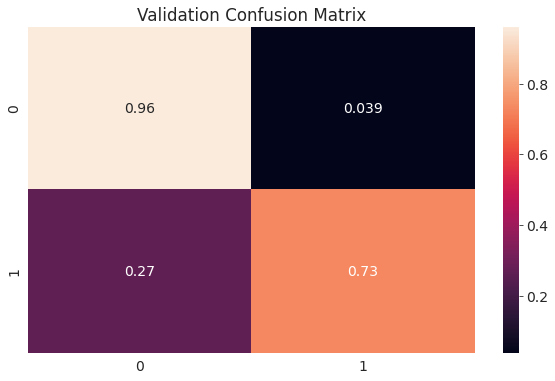

In [145]:
model_performance(model_dtc_best1, X_train, train_targets, X_val, val_targets)

In [146]:
model_dtc_best2 = DecisionTreeClassifier(max_depth = 8, min_samples_leaf = 12, random_state=42)

Train set accuracy: 92.54%
Validation set Accuracy: 92.44%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.96    195477
         1.0       0.78      0.74      0.76     37569

    accuracy                           0.92    233046
   macro avg       0.87      0.85      0.86    233046
weighted avg       0.92      0.92      0.92    233046

roc auc score: 0.85


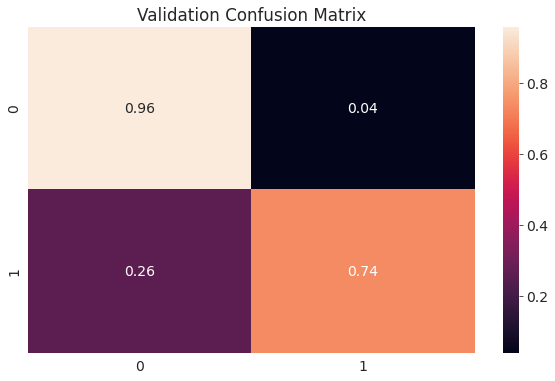

In [147]:
model_performance(model_dtc_best2, X_train, train_targets, X_val, val_targets)

Here, I preffer model-1

Results of training accuracy and validation accuracy are slightly better in Decision Tree Classification Model when compared to logistic model.roc_auc_score is almost same for both the models

for logistic Regression Model:
Train set accuracy: 92.36%, 
Validation set Accuracy: 92.28%,
roc auc score: 0.85


for Desision Tree Classification:
Train set accuracy: 92.57%,
Validation set Accuracy: 92.46%,
roc auc score: 0.85.


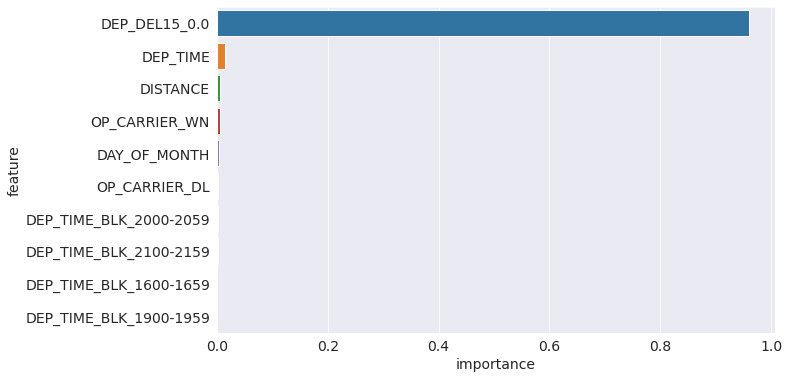

In [148]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model_dtc_best1.feature_importances_
})
sns.barplot(x = 'importance', y = 'feature', data = importance_df.sort_values('importance', ascending = False).head(10));

We will examine the performance of a different baseline model that forecasts delay at arrival as the same as delay at departure column since we can see a very large influence of "DEP DEL15" on prediction.

In [149]:
arr_preds_based_on_dep_delay = val_df['DEP_DEL15']
arr_preds_based_on_dep_delay

1164458    0.0
28495      0.0
138082     0.0
991299     0.0
238168     1.0
          ... 
1043081    1.0
945630     0.0
249425     0.0
868936     0.0
488954     0.0
Name: DEP_DEL15, Length: 233046, dtype: float64

In [150]:
accuracy_score(val_targets, arr_preds_based_on_dep_delay)

0.924087948302052

In [151]:
roc_auc_score(val_targets, arr_preds_based_on_dep_delay)

0.8522598750001426

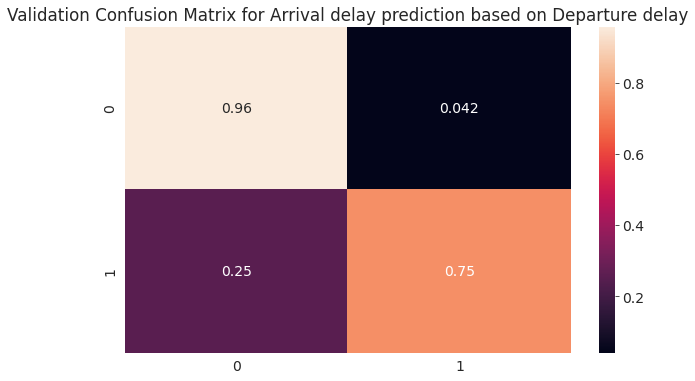

In [152]:
 conf_matrix_arr_based_on_dep_delay =  confusion_matrix(val_targets, arr_preds_based_on_dep_delay, normalize = 'true')
 plt.figure()
 plt.title('Validation Confusion Matrix for Arrival delay prediction based on Departure delay')
 sns.heatmap(conf_matrix_arr_based_on_dep_delay, annot = True);

As above results suggests our Decision Tree Classifier gives almost same performance to the model that just copying the departure delay column. We need to check more algorithms to outperform this baseline model.

#Random Forest Classification

A random forest works by averaging/combining the results of several decision trees:

<img src="https://1.bp.blogspot.com/-Ax59WK4DE8w/YK6o9bt_9jI/AAAAAAAAEQA/9KbBf9cdL6kOFkJnU39aUn4m8ydThPenwCLcBGAsYHQ/s0/Random%2BForest%2B03.gif" width="640">


In [153]:
from sklearn.ensemble import RandomForestClassifier

In [154]:
model_rf = RandomForestClassifier(n_jobs=-1, random_state=42)

In [155]:
%%time
model_rf.fit(X_train, train_targets)

CPU times: user 5min, sys: 2.2 s, total: 5min 2s
Wall time: 2min 35s


RandomForestClassifier(n_jobs=-1, random_state=42)

In [156]:
model_rf.score(X_train, train_targets)

0.9998197780695657

In [157]:
model_rf.score(X_val, val_targets)

0.9228049397972933

In [158]:
train_probs = model_rf.predict_proba(X_train)
train_probs

array([[0.99, 0.01],
       [1.  , 0.  ],
       [1.  , 0.  ],
       ...,
       [0.81, 0.19],
       [0.99, 0.01],
       [0.96, 0.04]])

accessing  individual decision tree

In [159]:
model_rf.estimators_[0]

DecisionTreeClassifier(max_features='auto', random_state=1608637542)

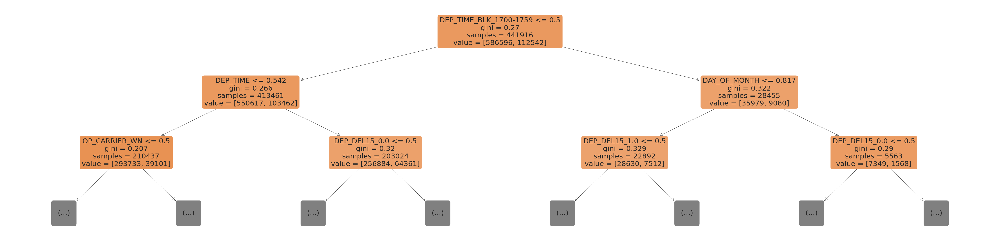

In [160]:
plt.figure(figsize=(80,20))
plot_tree(model_rf.estimators_[0], max_depth=2, feature_names=X_train.columns, filled=True,rounded=True);

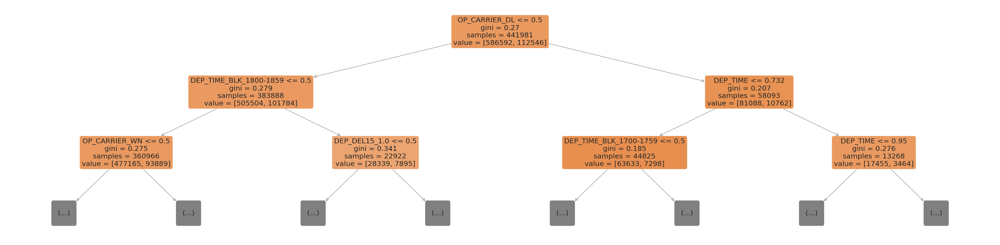

In [161]:
plt.figure(figsize=(80,20))
plot_tree(model_rf.estimators_[20], max_depth=2, feature_names=X_train.columns, filled=True,rounded=True);

In [162]:
len(model_rf.estimators_)

100

In [163]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model_rf.feature_importances_
}).sort_values('importance', ascending=False)

In [164]:
importance_df.head(10)

,feature,importance
27,DEP_DEL15_0.0,0.294403
28,DEP_DEL15_1.0,0.204029
1,DEP_TIME,0.187836
2,DISTANCE,0.166671
0,DAY_OF_MONTH,0.066196
36,DEP_TIME_BLK_1200-1259,0.003185
24,OP_CARRIER_WN,0.003156
6,DAY_OF_WEEK_4,0.003123
7,DAY_OF_WEEK_5,0.003111
5,DAY_OF_WEEK_3,0.002866


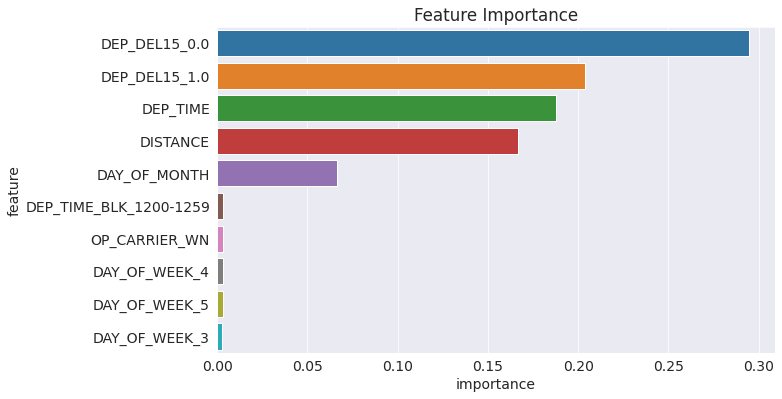

In [165]:
plt.title('Feature Importance')
sns.barplot(data=importance_df.head(10), x='importance', y='feature');

the distribution is a lot less skewed than that for a single decision tree.

###Hyperparameter Tuning with Random Forests

base model with which we can compare models with tuned hyperparameters

In [166]:
base_model_rf= RandomForestClassifier(random_state=42, n_jobs=-1).fit(X_train, train_targets)

In [167]:
base_train_acc = base_model_rf.score(X_train, train_targets)
base_val_acc = base_model_rf.score(X_val, val_targets)

In [168]:
base_accs = base_train_acc, base_val_acc
base_accs

(0.9998197780695657, 0.9228049397972933)

**n_estimators**

10 estimators

In [169]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=10)

In [170]:
model.fit(X_train, train_targets)

RandomForestClassifier(n_estimators=10, n_jobs=-1, random_state=42)

In [171]:
model.score(X_train, train_targets), model.score(X_val, val_targets)

(0.9891652291822215, 0.919114681221733)

In [172]:
base_accs

(0.9998197780695657, 0.9228049397972933)

200 estimators

In [173]:
model = RandomForestClassifier(random_state=42, n_jobs=-1, n_estimators=200)
model.fit(X_train, train_targets)

RandomForestClassifier(n_estimators=200, n_jobs=-1, random_state=42)

In [174]:
model.score(X_train, train_targets)

0.9998970160397518

In [175]:
model.score(X_val, val_targets)

0.9228349767856989

In [176]:
base_accs

(0.9998197780695657, 0.9228049397972933)

We can observe there is only slight increase in accuracy by doubling the number of estimators, but time require is much higher.

In [177]:
# function to quickly evaluate effect of different hyperparameters
def test_params_rfc(**params):
    model = RandomForestClassifier(n_jobs = -1, random_state = 42, **params).fit(X_train, train_targets)
    train_accuracy = model.score(X_train, train_targets)
    val_accuracy = model.score(X_val, val_targets)
    roc_auc_score_lr = roc_auc_score(val_targets, model.predict(X_val))
    print('Train set accuracy: {:.2f}%'.format(train_accuracy*100))
    print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
    print('roc auc score: {:.2f}'.format(roc_auc_score_lr))

In [178]:
test_params_rfc(n_estimators = 35)

Train set accuracy: 99.86%
Validation set Accuracy: 92.21%
roc auc score: 0.83


In [179]:
test_params_rfc(n_estimators = 50)

Train set accuracy: 99.91%
Validation set Accuracy: 92.25%
roc auc score: 0.83


In [180]:
test_params_rfc(n_estimators = 20)

Train set accuracy: 99.51%
Validation set Accuracy: 92.14%
roc auc score: 0.82


In [181]:
base_accs

(0.9998197780695657, 0.9228049397972933)

max_depth and max_leaf_nodes

In [182]:
test_params_rfc(max_depth=5)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [183]:
test_params_rfc(n_estimators=50,max_depth =5)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [184]:
test_params_rfc(n_estimators=20,max_depth =5)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [185]:
test_params_rfc(n_estimators=20,max_depth =7)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [186]:
test_params_rfc(n_estimators=20,max_depth =9)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [187]:
test_params_rfc(n_estimators=20,max_depth =11)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [188]:
test_params_rfc(n_estimators=20,max_depth =15)

Train set accuracy: 92.58%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [189]:
test_params_rfc(n_estimators=20,max_depth =25)

Train set accuracy: 94.47%
Validation set Accuracy: 92.51%
roc auc score: 0.84


In [190]:
test_params_rfc(n_estimators=20,max_depth =10)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [191]:
test_params_rfc(n_estimators=20,max_depth =20)

Train set accuracy: 93.15%
Validation set Accuracy: 92.49%
roc auc score: 0.85


In [192]:
test_params_rfc(n_estimators=20,max_depth =50)

Train set accuracy: 99.51%
Validation set Accuracy: 92.12%
roc auc score: 0.82


In [193]:
test_params_rfc(n_estimators=20,max_depth =64)

Train set accuracy: 99.51%
Validation set Accuracy: 92.12%
roc auc score: 0.82


In [194]:
test_params_rfc(n_estimators=20,max_depth =23)

Train set accuracy: 93.85%
Validation set Accuracy: 92.49%
roc auc score: 0.85


In [195]:
test_params_rfc(n_estimators=20,max_depth =24)

Train set accuracy: 94.20%
Validation set Accuracy: 92.51%
roc auc score: 0.84


In [196]:
test_params_rfc(n_estimators=20,max_depth =27)

Train set accuracy: 95.24%
Validation set Accuracy: 92.48%
roc auc score: 0.84


In [197]:
test_params_rfc(n_estimators = 20, max_leaf_nodes = 32)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [198]:
test_params_rfc(n_estimators = 20, max_leaf_nodes = 64)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [199]:
test_params_rfc(n_estimators = 20, max_leaf_nodes = 128)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [200]:
test_params_rfc(n_estimators = 20, max_leaf_nodes = 256)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [201]:
test_params_rfc(n_estimators = 20, max_leaf_nodes = 2**25)

Train set accuracy: 99.50%
Validation set Accuracy: 92.10%
roc auc score: 0.82


 min_samples_leaf

In [202]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 2)

Train set accuracy: 94.74%
Validation set Accuracy: 92.48%
roc auc score: 0.84


In [203]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 4)

Train set accuracy: 93.22%
Validation set Accuracy: 92.52%
roc auc score: 0.85


In [204]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 5)

Train set accuracy: 93.01%
Validation set Accuracy: 92.50%
roc auc score: 0.85


In [205]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 6)

Train set accuracy: 92.88%
Validation set Accuracy: 92.49%
roc auc score: 0.85


In [206]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 7)

Train set accuracy: 92.82%
Validation set Accuracy: 92.48%
roc auc score: 0.85


In [207]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 8)

Train set accuracy: 92.77%
Validation set Accuracy: 92.47%
roc auc score: 0.85


In [208]:
test_params_rfc(n_estimators = 20, min_samples_leaf = 20)

Train set accuracy: 92.52%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [209]:
test_params_rfc(n_estimators = 20,max_depth=24, min_samples_leaf = 4)

Train set accuracy: 92.90%
Validation set Accuracy: 92.50%
roc auc score: 0.85


In [210]:
model_rfc_best = RandomForestClassifier(n_jobs = -1, random_state = 42, n_estimators = 20, min_samples_leaf = 4)

Train set accuracy: 93.22%
Validation set Accuracy: 92.52%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.96    195477
         1.0       0.79      0.73      0.76     37569

    accuracy                           0.93    233046
   macro avg       0.87      0.85      0.86    233046
weighted avg       0.92      0.93      0.92    233046

roc auc score: 0.85


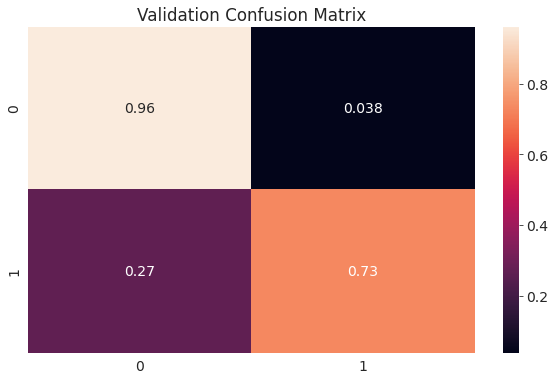

In [211]:
model_performance(model_rfc_best, X_train, train_targets, X_val, val_targets)


for Random Forest classification:
Train set accuracy: 93.22%
Validation set Accuracy: 92.52%
roc auc score: 0.85

for logistic Regression Model: Train set accuracy: 92.36%, Validation set Accuracy: 92.28%, roc auc score: 0.85

for Desision Tree Classification: Train set accuracy: 92.57%, Validation set Accuracy: 92.46%, roc auc score: 0.85


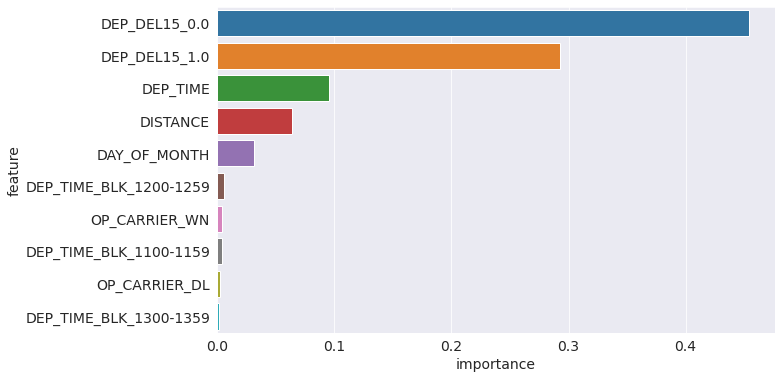

In [212]:
importance_df = pd.DataFrame({
    'feature': X_train.columns,
    'importance': model_rfc_best.feature_importances_
})
sns.barplot(x = 'importance', y = 'feature', data = importance_df.sort_values('importance', ascending = False).head(10));

By examining the feature importance we can understand that the Random Forest model is best as it depends on many features for prediction unlike Decision Tree model which mostly depends on one feature. we can hope our Random Forest will perform better to unknown data.



#XGBoost Classifier

In [213]:
from xgboost import XGBClassifier

In [214]:
model = XGBClassifier(random_state=42, n_jobs = -1,use_label_encoder=False, eval_metric = 'logloss')

In [215]:
%%time
model.fit(X_train, train_targets)

CPU times: user 2min 26s, sys: 1.12 s, total: 2min 27s
Wall time: 1min 15s


XGBClassifier(eval_metric='logloss', n_jobs=-1, random_state=42,
              use_label_encoder=False)

In [216]:
model.score(X_train, train_targets)

0.9248016843598832

In [217]:
model.score(X_val, val_targets)

0.924113694292114

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.96      0.95    195477
         1.0       0.77      0.75      0.76     37569

    accuracy                           0.92    233046
   macro avg       0.86      0.85      0.86    233046
weighted avg       0.92      0.92      0.92    233046

roc auc score: 0.85


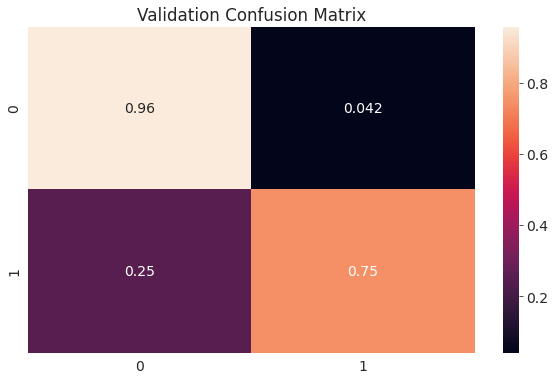

In [218]:
model_performance(model, X_train, train_targets, X_val, val_targets)

###visualization

In [219]:
import matplotlib.pyplot as plt
from xgboost import plot_tree
from matplotlib.pylab import rcParams
%matplotlib inline

rcParams['figure.figsize'] = 30,30

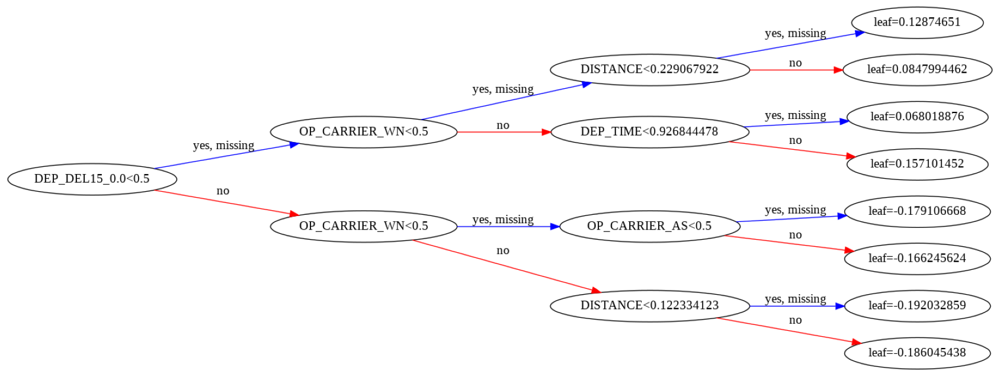

In [220]:
plot_tree(model, rankdir='LR');

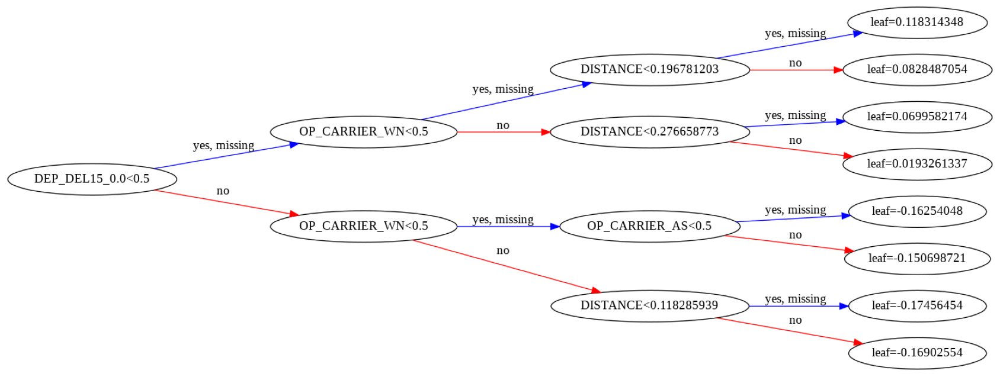

In [221]:
plot_tree(model, rankdir='LR', num_trees=1);

In [222]:
trees = model.get_booster().get_dump()

In [223]:
trees = model.get_booster().get_dump()

In [224]:
print(trees[0])

0:[DEP_DEL15_0.0<0.5] yes=1,no=2,missing=1
	1:[OP_CARRIER_WN<0.5] yes=3,no=4,missing=3
		3:[DISTANCE<0.229067922] yes=7,no=8,missing=7
			7:leaf=0.12874651
			8:leaf=0.0847994462
		4:[DEP_TIME<0.926844478] yes=9,no=10,missing=9
			9:leaf=0.068018876
			10:leaf=0.157101452
	2:[OP_CARRIER_WN<0.5] yes=5,no=6,missing=5
		5:[OP_CARRIER_AS<0.5] yes=11,no=12,missing=11
			11:leaf=-0.179106668
			12:leaf=-0.166245624
		6:[DISTANCE<0.122334123] yes=13,no=14,missing=13
			13:leaf=-0.192032859
			14:leaf=-0.186045438



###Feature importance

###Hyperparameter Tuning for XGBClassifier

In [225]:
# function to quickly evaluate effect of different hyperparameters
def test_params_xgbc(**params):
    model = XGBClassifier(random_state=42, n_jobs = -1,use_label_encoder=False, eval_metric = 'logloss', **params).fit(X_train, train_targets)
    train_accuracy = model.score(X_train, train_targets)
    val_accuracy = model.score(X_val, val_targets)
    roc_auc_score_lr = roc_auc_score(val_targets, model.predict(X_val))
    print('Train set accuracy: {:.2f}%'.format(train_accuracy*100))
    print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
    print('roc auc score: {:.2f}'.format(roc_auc_score_lr))

number of estimators

In [226]:
test_params_xgbc(n_estimators = 10)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [227]:
test_params_xgbc(n_estimators = 20)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [228]:
test_params_xgbc(n_estimators = 30)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [229]:
test_params_xgbc(n_estimators = 50)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


max_depth

In [230]:
test_params_xgbc(n_estimators = 10, max_depth = 5)


Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [231]:
test_params_xgbc(n_estimators = 20, max_depth = 5)


Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [232]:
test_params_xgbc(n_estimators = 50, max_depth = 5)


Train set accuracy: 92.50%
Validation set Accuracy: 92.43%
roc auc score: 0.85


In [233]:
test_params_xgbc(n_estimators = 10, max_depth = 10)

Train set accuracy: 92.65%
Validation set Accuracy: 92.47%
roc auc score: 0.85


In [234]:
test_params_xgbc(n_estimators = 10, max_depth = 20)

Train set accuracy: 93.85%
Validation set Accuracy: 92.54%
roc auc score: 0.84


learning_rate

In [235]:
test_params_xgbc(n_estimators = 10, learning_rate = 0.2)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [236]:
test_params_xgbc(n_estimators = 10, learning_rate = 0.3)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [237]:
test_params_xgbc(n_estimators = 10, learning_rate = 0.4)

Train set accuracy: 92.48%
Validation set Accuracy: 92.41%
roc auc score: 0.85


In [238]:
test_params_xgbc(n_estimators = 10, learning_rate = 0.5)

Train set accuracy: 92.49%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [239]:
test_params_xgbc(n_estimators = 10, learning_rate = 0.6)

Train set accuracy: 92.49%
Validation set Accuracy: 92.42%
roc auc score: 0.85


In [240]:
test_params_xgbc(n_estimators = 40, max_depth = 7, learning_rate = 0.5)

Train set accuracy: 92.93%
Validation set Accuracy: 92.70%
roc auc score: 0.84


In [241]:
test_params_xgbc(n_estimators = 40, max_depth = 7, learning_rate = 0.3)

Train set accuracy: 92.83%
Validation set Accuracy: 92.69%
roc auc score: 0.85


In [242]:
test_params_xgbc(n_estimators = 50, max_depth = 7, learning_rate = 0.3)

Train set accuracy: 92.87%
Validation set Accuracy: 92.70%
roc auc score: 0.84


In [243]:
test_params_xgbc(n_estimators = 50, max_depth = 7, learning_rate = 0.5)

Train set accuracy: 93.00%
Validation set Accuracy: 92.70%
roc auc score: 0.84


In [244]:
model_xgbc_best = XGBClassifier(n_estimators = 40, max_depth = 7, learning_rate = 0.5, random_state=42, n_jobs = -1,use_label_encoder=False, eval_metric = 'logloss')

Train set accuracy: 92.93%
Validation set Accuracy: 92.70%
Validation Classification report: 
               precision    recall  f1-score   support

         0.0       0.95      0.97      0.96    195477
         1.0       0.81      0.71      0.76     37569

    accuracy                           0.93    233046
   macro avg       0.88      0.84      0.86    233046
weighted avg       0.92      0.93      0.93    233046

roc auc score: 0.84


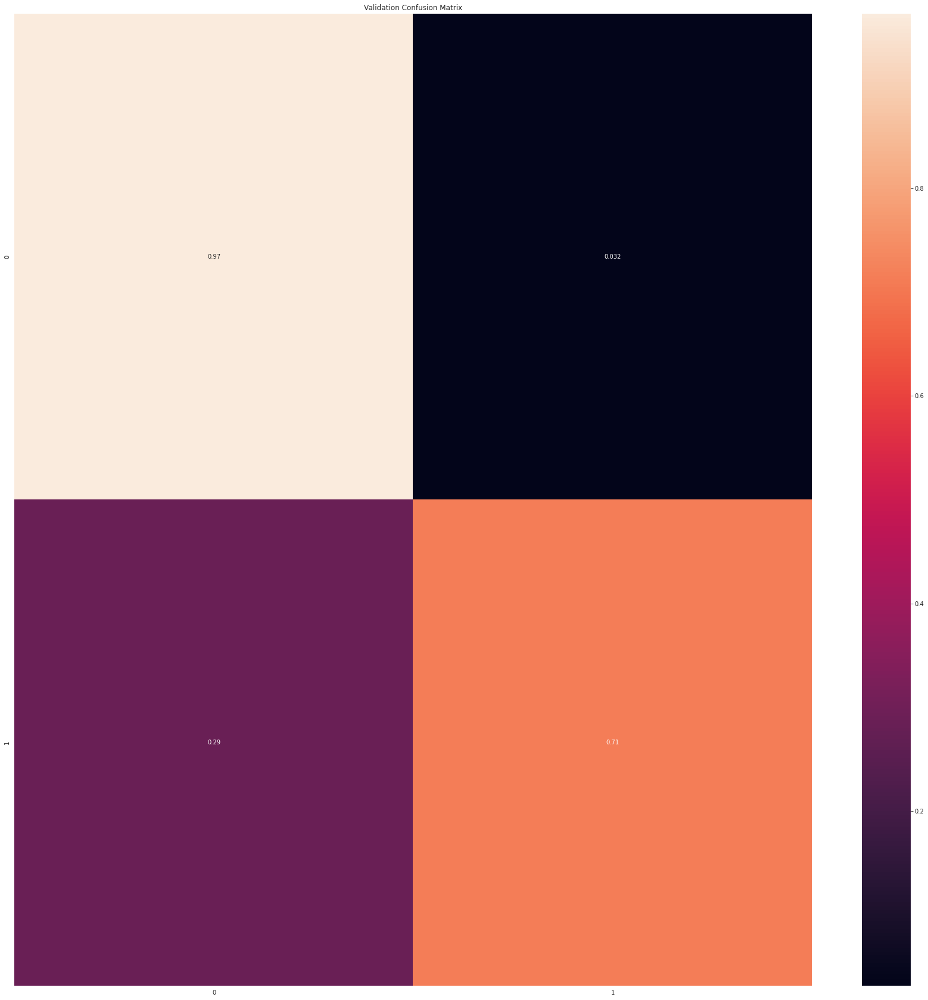

In [245]:
model_performance(model_xgbc_best, X_train, train_targets, X_val, val_targets)

#Making Predictions on New Inputs

To predict delay on arrival for a single input (details of a single trip) we can write a function as follows. The two dictionaries, origin_cat_dict and dest_cat_dict are used for getting corresponding category for origin and destination airports.



In [246]:
# function to predict sample input
def predict_input(model, single_input):
    input_df = pd.DataFrame([single_input])
    input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
    input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
    X_input = input_df[numeric_cols + encoded_cols]
    pred = model.predict(X_input)[0]
    prob = model.predict_proba(X_input)[0][list(model.classes_).index(pred)]
    return pred, prob

A single input by the name new_input is shown below.

In [247]:
new_input = {'DAY_OF_MONTH': 3,
             'DAY_OF_WEEK': 2,
             'OP_CARRIER': '9E',
             'DEP_TIME': 1225.0,
             'DEP_DEL15': 0.0,
             'DEP_TIME_BLK': '1200-1259',
             'DISTANCE': 578.0 }

We use above function for prediction of arrival delay for the given input. We will use the logistic regression model named model_lr.

In [248]:
predict_input(model_lr, new_input)

(0.0, 0.9645689079370265)

In [249]:
input_cols=['DAY_OF_MONTH','DAY_OF_WEEK','OP_CARRIER','DEP_TIME','DEP_DEL15','DEP_TIME_BLK','DISTANCE',]

###Compare different models on Test Data

In [250]:
model_lr = LogisticRegression(solver = 'liblinear', random_state = 42)
model_dtc_best1 = DecisionTreeClassifier(max_depth = 10, min_samples_leaf = 64, random_state=42)
model_dtc_best2 = DecisionTreeClassifier(max_depth = 8, min_samples_leaf = 12, random_state=42)
model_rfc_best = RandomForestClassifier(n_jobs = -1, random_state = 42, n_estimators = 20, min_samples_leaf = 4)
model_xgbc_best = XGBClassifier(n_estimators = 40, max_depth = 7, learning_rate = 0.5, random_state=42, n_jobs = -1,use_label_encoder=False, eval_metric = 'logloss')

In [251]:
models = [model_lr, model_dtc_best1,model_dtc_best2, model_rfc_best, model_xgbc_best]
accuracy_scores = []
roc_auc_scores = []


In [252]:
for model in models:
  model.fit(X_train, train_targets)
  test_preds = model.predict(X_test)
  test_accuracy = accuracy_score(test_targets, test_preds)
  roc_auc_score_test = roc_auc_score(test_targets, test_preds)
  accuracy_scores.append(round(test_accuracy*100, 2))
  roc_auc_scores.append(round(roc_auc_score_test, 3))

In [253]:
test_results_df = pd.DataFrame({
    'Model' : ['Logistic Regression', 'Decision Tree Classifier_1', 'Decision Tree Classifier_2','Random Forest Classifier', 'XGBoost Classifier'],
    'Accuracy': accuracy_scores,
    'roc_auc_score': roc_auc_scores
})

In [254]:
test_results_df

,Model,Accuracy,roc_auc_score
0,Logistic Regression,92.37,0.849
1,Decision Tree Classifier_1,92.55,0.848
2,Decision Tree Classifier_2,92.51,0.850
3,Random Forest Classifier,92.59,0.847
4,XGBoost Classifier,92.78,0.841


Let's also add the model which predicts arrival delay purely by copying departure delay to the above dataframe to compare with our models.

In [255]:
test_dep_delay = test_df['DEP_DEL15']

In [256]:
accuracy_copy_model = round(accuracy_score(test_targets, test_dep_delay)*100, 2)

In [257]:
roc_auc_copy_model = round(roc_auc_score(test_targets, test_dep_delay), 3)

In [258]:
test_results_df.loc[5] = ['Departure Delay Copy Model', accuracy_copy_model, roc_auc_copy_model]

In [259]:
test_results_df

,Model,Accuracy,roc_auc_score
0,Logistic Regression,92.37,0.849
1,Decision Tree Classifier_1,92.55,0.848
2,Decision Tree Classifier_2,92.51,0.850
3,Random Forest Classifier,92.59,0.847
4,XGBoost Classifier,92.78,0.841
5,Departure Delay Copy Model,92.49,0.853


#Saving and Loading Trained Models

Now we will save check performance of our best model and save the model weights and other required items for future use,

In [260]:
model_best = XGBClassifier(n_estimators = 40, max_depth = 7, learning_rate = 0.5, random_state=42, n_jobs = -1,use_label_encoder=False, eval_metric = 'logloss')

In [261]:
model_best.fit(X_train, train_targets)

XGBClassifier(eval_metric='logloss', learning_rate=0.5, max_depth=7,
              n_estimators=40, n_jobs=-1, random_state=42,
              use_label_encoder=False)

Train set Accuracy: 92.93%
Validation set Accuracy: 92.70%
Test set Accuracy: 92.78%
roc auc score on Test data: 0.84


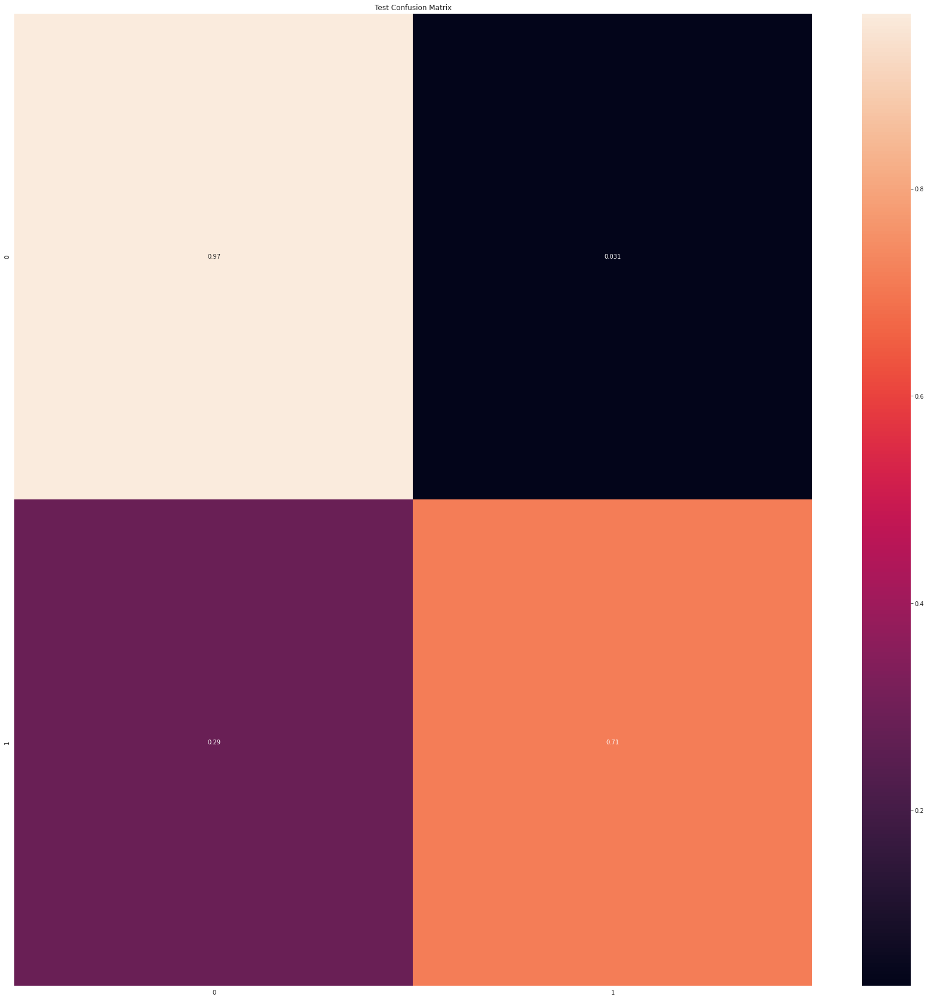

In [262]:
train_preds = model_best.predict(X_train)
val_preds = model_best.predict(X_val)
test_preds = model_best.predict(X_test)
train_accuracy = accuracy_score(train_targets, train_preds)
val_accuracy = accuracy_score(val_targets, val_preds)
test_accuracy = accuracy_score(test_targets, test_preds)
print('Train set Accuracy: {:.2f}%'.format(train_accuracy*100))
print('Validation set Accuracy: {:.2f}%'.format(val_accuracy* 100))
print('Test set Accuracy: {:.2f}%'.format(test_accuracy* 100))
print('roc auc score on Test data: {:.2f}'.format(roc_auc_score(test_targets, test_preds)))  
conf_matrix =  confusion_matrix(test_targets, test_preds, normalize = 'true')
plt.figure()
plt.title('Test Confusion Matrix')
sns.heatmap(conf_matrix, annot = True);

In [263]:
import joblib

In [264]:
flight_arrival_delay_prediction = {
    'model': model_best,
    'scaler': scaler,
    'encoder': encoder,
    'input_cols': input_cols,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols,
    'encoded_cols': encoded_cols
}

In [265]:
joblib.dump(flight_arrival_delay_prediction, 'flight_arrival_delay_prediction.joblib')

['flight_arrival_delay_prediction.joblib']

In [266]:
flight_delay_2 = joblib.load('flight_arrival_delay_prediction.joblib')

In [267]:
predict_input(flight_delay_2['model'], new_input)

(0.0, 0.9554736)

[jovian] Detected Colab notebook...


[jovian] Error: jovian.commit doesn't work on Colab unless the notebook was created and executed from Jovian.
Make sure to run the first code cell at the top after executing from Jovian.
Alternatively, you can download this notebook and upload it manually to Jovian.
Learn more: https://jovian.ai/docs/user-guide/run.html#run-on-colab
